Using the `he_vis_eval` Conda environment.

**Visualisation of correct tiles normalisation results**

In this notebook I'm going to visualise the results of the normalisation on the single tiles.\
Different algorithms and target images/parameters have been used:

- from HistomicsTK:
    - Reinhard with masking
    - Reinhard without masking
    - Macenko with masking
    - Macenko without masking
- from StainTools:
    - Reinhard
    - Macenko
    - Vahadane
- from TorchVahadane:
    - Vahadane on CPU
    - Vahadane on GPU
- from StainNET
    - StainNET pre-trained with the Camelyon16 breast cancer dataset
    - StainGAN model A pre-trained with the Camelyon16 breast cancer dataset
    - StainGAN model B pre-trained with the Camelyon16 breast cancer dataset

In most of the cases these are the same methods applied different times, so they should return the same results. However, the different in using or not using the masks should be visible.

---
# 0. - Imports and paths

In [2]:
import os
import pandas as pd
import matplotlib.font_manager as fm
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import seaborn as sns
from PIL import Image, ImageDraw
import math 
import numpy as np
from skimage.metrics import structural_similarity as ssim, peak_signal_noise_ratio as psnr
import warnings
import subprocess
import lpips
from IPython import embed
import torch, torchvision


In [3]:
# Fetch DM Sans font file from https://github.com/google/fonts/blob/main/ofl/dmsans/DMSans%5Bopsz%2Cwght%5D.ttf or, better, https://fonts.google.com/specimen/DM+Sans
font_path = "../fonts/static/DMSans-SemiBold.ttf" 

# Add font to matplotlib
try:
    fm.fontManager.addfont(font_path)
    plt.rcParams['font.family'] = 'DM Sans'
except RuntimeError as e:
    print(f"Failed to load font: {e}")

# sns.set_theme(font_scale=1.5, style="whitegrid")
# biomodal_palette = ["#9CDBD9", "#C0DF16","#003B49","#05868E", "#ABAD9A", "#F87C56","#00DAEF","#50B37B"]
# sns.set_palette(biomodal_palette)

In [4]:
# # Test plot
# plt.figure(figsize=(6, 4))
# plt.title("Test Plot with DM Sans Font μ", fontsize=16)
# plt.plot([1, 2, 3], [4, 6, 8])
# plt.show()


In [5]:
os.chdir("/disk2/user/gabgam/work/gigi_env/the_project/2_image_normalisation/")
print(os.getcwd())

/disk2/work/gabgam/gigi_env/the_project/2_image_normalisation


Uncomment for the FF Visium sample.

In [6]:

# # PARAMETER THAT MUST BE SPECIFIED TO AUTOMATICALLY LOOK FOR THE CORRECT FOLDERS AND PATHS
# IMAGE_VERSION_AND_COORDINATE_SYSTEM = "img_not_changed_allspots" 
# SPATIAL_VISIUM_SAMPLE = "2022_FF_WG_10X"

# # path to all wsi-derived tiles directories, including normalised WSI
# PATH_TO_TILES_DIRECTORY = f"/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/visium_{SPATIAL_VISIUM_SAMPLE}/tiling_output/"
# # all wsi-derived tiles directories
# paths_to_tiles_from_wsis = [os.path.join(PATH_TO_TILES_DIRECTORY, i) for i in os.listdir(PATH_TO_TILES_DIRECTORY) if i.startswith(IMAGE_VERSION_AND_COORDINATE_SYSTEM)] # all the folder for tiles from WSIs, including the original one
# print(paths_to_tiles_from_wsis)

# # path to directories of singularly normalised tiles
# PATH_TO_NORMALISED_TILES = f"./output/visium_{SPATIAL_VISIUM_SAMPLE}/{IMAGE_VERSION_AND_COORDINATE_SYSTEM}/"

# # path to the target image
# PATH_TO_REFERENCE = "./reference_images/reference_full.jpeg"
# TARGET_IS = "target_is_reference_full"

# # make folder for saving the resultS
# FIGURES_PATH = f"figures/{SPATIAL_VISIUM_SAMPLE}_{IMAGE_VERSION_AND_COORDINATE_SYSTEM}/"
# os.makedirs(FIGURES_PATH, exist_ok=True)

# Background color of the slide. Used for evaluating the number of tiles with too much white component
# REFERENCE_COLOR = [185, 185, 192]  # Average RGB of the near-white color, sampled from the image.
# REFERENCE_COLOR = [214, 207, 210]  # Average RGB of the near-white color, sampled from the image.

Uncomment for the FFPE Visium sample.

In [7]:

# PARAMETER THAT MUST BE SPECIFIED TO AUTOMATICALLY LOOK FOR THE CORRECT FOLDERS AND PATHS
IMAGE_VERSION_AND_COORDINATE_SYSTEM = "img_not_changed_allspots" 
SPATIAL_VISIUM_SAMPLE = "FFPE_dcis_idc_10X"

# path to all wsi-derived tiles directories, including normalised WSI
PATH_TO_TILES_DIRECTORY = f"/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/visium_{SPATIAL_VISIUM_SAMPLE}/tiling_output/"
# all wsi-derived tiles directories
paths_to_tiles_from_wsis = [os.path.join(PATH_TO_TILES_DIRECTORY, i) for i in os.listdir(PATH_TO_TILES_DIRECTORY) if i.startswith(IMAGE_VERSION_AND_COORDINATE_SYSTEM)] # all the folder for tiles from WSIs, including the original one
print(paths_to_tiles_from_wsis)

# path to directories of singularly normalised tiles
PATH_TO_NORMALISED_TILES = f"./output/visium_{SPATIAL_VISIUM_SAMPLE}/{IMAGE_VERSION_AND_COORDINATE_SYSTEM}/"

# path to the target image
PATH_TO_REFERENCE = "./reference_images/reference_full.jpeg"
TARGET_IS = "target_is_reference_full"

# make folder for saving the resultS
FIGURES_PATH = f"figures/{SPATIAL_VISIUM_SAMPLE}_{IMAGE_VERSION_AND_COORDINATE_SYSTEM}/"
os.makedirs(FIGURES_PATH, exist_ok=True)

# Background color of the slide. Used for evaluating the number of tiles with too much white component
REFERENCE_COLOR = [255, 255, 255]  # Average RGB of the near-white color, sampled from the image.

['/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/visium_FFPE_dcis_idc_10X/tiling_output/img_not_changed_allspots', '/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/visium_FFPE_dcis_idc_10X/tiling_output/img_not_changed_allspots_histomicsTK_macenko_nomasking_target_is_reference_full', '/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/visium_FFPE_dcis_idc_10X/tiling_output/img_not_changed_allspots_histomicsTK_macenko_withmasking_target_is_reference_full', '/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/visium_FFPE_dcis_idc_10X/tiling_output/img_not_changed_allspots_staintools_reinhard_target_is_reference_full']


In [8]:
def normalisations_summary_from_tiles(base_dir):
    '''
    Returns a dataframe containing the number of tiles (as `.jpg` files) per normalisation method, target and the relative path.
    '''
    # Initialize a list to hold the data for the DataFrame
    data = []
        
    # Walk through the directory structure
    for root, dirs, files in os.walk(base_dir):
        # Filter .jpg files
        jpg_count = len([f for f in files if f.lower().endswith('.jpg')])

        # Parse normalisation method and target from the directory structure
        relative_path = os.path.relpath(root, base_dir)
        path_parts = relative_path.split(os.sep)

        # Initialize variables
        normalisation_method = path_parts[0] if len(path_parts) >= 1 else None
        target = "-"

        # Check for specific targets or models in deeper paths
        if len(path_parts) > 1:
            if path_parts[1].startswith("target"):
                target = path_parts[1]
            elif path_parts[1].startswith("model"):
                normalisation_method = f"{normalisation_method}_{path_parts[1]}"

        # Add the data row if a normalisation method is valid
        if normalisation_method:
            data.append({
                "Normalisation Method": normalisation_method,
                "Target": target,
                "Number of tiles": jpg_count,
                #"Path to folder": relative_path # path to the final folder as well
                "Path to folder": root # path to the final folder as well
            })
            
    
    # Create a DataFrame and filter for methods that worked
    df = pd.DataFrame(data)
    df = df[df["Number of tiles"] > 0]

    # Optionally, sort the DataFrame for better readability
    df = df.sort_values(by=["Normalisation Method", 
                            "Target"]).reset_index(drop=True)
    
    return df

# ------------------------------------------------------------------------------------------------------------------------
def normalisations_summary_from_visium_WSI(base_dir, original_image_name):
    '''
    Returns a dataframe containing the number of tiles (as `.jpg` files) per normalisation method, target and the relative path derived from the original or normalised WSI.
    '''
    # Initialize a list to hold the data for the DataFrame
    data = []
    
    # Filter .jpg files
    jpg_count = len([f for f in os.listdir(base_dir) if f.lower().endswith('.jpg')])

    temp_method_n_target = base_dir.split("/")[-3]
    print(f"Processing folder: {temp_method_n_target}")
    temp_for_naming = temp_method_n_target.split("_")
    
    if temp_method_n_target == original_image_name:
        normalisation_method = "ORIGINAL WSI"
        target = "-"
    
    # elif (temp_for_naming[0] + "_" + temp_for_naming[1]) == original_image_name and len(temp_for_naming) > 2:
    #     normalisation_method = temp_method_n_target.replace((original_image_name + "_"), '').split("_target")[0] # select just the normalisation method name
    #     target = temp_method_n_target.split((normalisation_method + "_"))[1] # select just the target name
    #     normalisation_method = "fromWSI_" + normalisation_method
    
    # adaption to visium
    elif temp_method_n_target.startswith(original_image_name + "_"):
        normalisation_method = temp_method_n_target.replace((original_image_name + "_"), '').split("_target")[0]  # Extract method name
        target_parts = temp_method_n_target.split("_target")
    
        if len(target_parts) > 1:
            target = "target" + target_parts[1]  # Extract target name
        else:
            target = "Unknown"

        normalisation_method = "fromWSI_" + normalisation_method
    
    else:
        normalisation_method = None 
        
    if normalisation_method:
        data.append({
            "Normalisation Method": normalisation_method,
            "Target": target,
            "Number of tiles": jpg_count,
            #"Path to folder": relative_path # path to the final folder as well
            "Path to folder": base_dir # path to the final folder as well
        })
    print(jpg_count)
    # Create a DataFrame and filter for methods that worked (more than 0 tiles)
    df = pd.DataFrame(data)    
    df = df[df["Number of tiles"] > 0]

    # Optionally, sort the DataFrame for better readability
    df = df.sort_values(by=["Normalisation Method", 
                            "Target"]).reset_index(drop=True)
    
    return df


# ------------------------------------------------------------------------------------------------------------------------
def cap_sentence(s):
    """
    Very simple function for capitalising the first character of every word.
    
    Paraters:
    s (string): string to modify.
    """
    return ''.join( (c.upper() if i == 0 or s[i-1] == ' ' else c) for i, c in enumerate(s) )


# ------------------------------------------------------------------------------------------------------------------------
def rgb_to_tuple(rgb_string):
    return tuple(int(x) / 255.0 for x in rgb_string.split(":"))


# ------------------------------------------------------------------------------------------------------------------------
def plot_normalisation_tiles(df, tile_size):
    """
    Create a bar plot showing the number of tiles per normalisation method for a given tile size.
    
    Parameters:
    df (pd.DataFrame): Dataframe containing normalisation method and number of tiles.
    tile_size (int): The size of the tiles in micrometers (e.g., 100 for 100um).
    """
    # Filter for Target being '-' or 'target_is_reference_full'
    df_filtered = df[df["Target"].isin(["-", TARGET_IS])]
    
    # Highlight "ORIGINAL WSI" separately
    original_value = df_filtered[df_filtered["Normalisation Method"] == "ORIGINAL WSI"]["Number of tiles"].iloc[0]
    
    # New names for better appearance
    new_names = [cap_sentence(i.replace("_", " ")) for i in df_filtered["Normalisation Method"]]    
    
    # Karolinska Institutet colors
    bar_colors = [ 
        rgb_to_tuple("79:4:51") if method == "ORIGINAL WSI" 
        else rgb_to_tuple("135:0:82") if method.startswith("fromWSI")
        else rgb_to_tuple("255:135:111") 
        for method in df_filtered["Normalisation Method"]
    ]
    
    # Create the bar plot
    plt.figure(figsize=(14, 7))
    bars = plt.bar(
        new_names, 
        df_filtered["Number of tiles"], 
        color=bar_colors, 
        edgecolor="black", 
        width=0.6
    )
    
    # Add a horizontal line for "ORIGINAL WSI"
    plt.axhline(original_value, color="red", linestyle="--", linewidth=1.5)
    plt.text(
        len(df_filtered) - 1.5, original_value + 50,
        f"ORIGINAL WSI: {original_value}", 
        color="red", 
        fontsize=10, 
        ha="right"
    )
    
    # Rotate the method names
    plt.xticks(rotation=45, ha="right", fontsize=12)
    
    # Remove legend
    plt.gca().legend_ = None
    
    # Add the values inside the bars
    for bar in bars:
        height = bar.get_height()
        plt.text(
            bar.get_x() + bar.get_width() / 2, 
            height - 150,
            f"{int(height)}", 
            ha="center", 
            color="white", 
            fontsize=10, 
            weight="bold"
        )
    
    # Improve plot appearance
    plt.title(f"Number of tiles per normalisation method - {tile_size} um tiles", fontsize=16)
    plt.ylabel("Number of Tiles", fontsize=14)
    plt.tight_layout()
    
    plt.savefig(os.path.join(FIGURES_PATH, f"summary_of_normalisation_{tile_size}um_tiles.png"), format = "PNG")
    plt.savefig(os.path.join(FIGURES_PATH, f"summary_of_normalisation_{tile_size}um_tiles.pdf"), format = "PDF")
    
    # Show the plot
    plt.show()


# ------------------------------------------------------------------------------------------------------------------------
def plot_comparison_by_origin(list_of_lists, tile_to_visualise, tile_size):
    """
    Plots and saves comparison images for each normalization method.
    
    Parameters:
    - list_of_lists: List of lists containing method names and folder paths.
    - tile_to_visualise: Name of the tile to visualize.
    - tile_size: Size of the tile (e.g., "100um"), used for saving filenames.
    """
    origin_names = [method.split(" ")[0] for method in [item[0] for item in list_of_lists] if method.split(" ")[0] not in ["ORIGINAL", "Target"]]

    for origin in set(origin_names):
        
        # in case of DL models we don't want to plot the target image, so we just select the tile from original WSI
        if origin in ["StainNET", "StainGAN"]:
            just_original_n_target = [these for these in list_of_lists if these[0].startswith(("ORIGINAL"))] 
            temp_list_of_list_for_origin = just_original_n_target + [i for i in list_of_lists if i[0].startswith(origin)]
            
        else: 
            just_original_n_target = [these for these in list_of_lists if these[0].startswith(("ORIGINAL", "Target"))]
            temp_list_of_list_for_origin = just_original_n_target + [i for i in list_of_lists if i[0].startswith(origin)]
            
            
        n_rows, n_cols = 1, len(temp_list_of_list_for_origin)
        fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 5))
        font = 15

        for i, ax in enumerate(axes.flat):
            if temp_list_of_list_for_origin[i][0] == "ORIGINAL WSI":
                for tile in os.listdir(temp_list_of_list_for_origin[i][1]):
                    if tile.startswith(tile_to_visualise):
                        img = Image.open(os.path.join(temp_list_of_list_for_origin[i][1], tile))
                        ax.imshow(img)
                        ax.set_title(f"TILE FROM THE {temp_list_of_list_for_origin[i][0]}", fontsize=font)

            elif temp_list_of_list_for_origin[i][0] == "Target image":
                target = Image.open(temp_list_of_list_for_origin[i][1])
                new_size = (556, 556)
                resized_target = target.resize(new_size, Image.Resampling.LANCZOS)
                ax.imshow(resized_target)
                ax.set_title(temp_list_of_list_for_origin[i][0], fontsize=font)

            else:
                for tile in os.listdir(temp_list_of_list_for_origin[i][1]):
                    if tile.startswith(tile_to_visualise):
                        img = Image.open(os.path.join(temp_list_of_list_for_origin[i][1], tile))
                        ax.imshow(img)
                        ax.set_title(temp_list_of_list_for_origin[i][0], fontsize=font)

            ax.axis("off")

        plt.tight_layout()
        fig.savefig(os.path.join(FIGURES_PATH, f"comparison_{origin}_results_for_{tile_to_visualise}_{tile_size}.pdf"), format="pdf", bbox_inches="tight")
        fig.savefig(os.path.join(FIGURES_PATH, f"comparison_{origin}_results_for_{tile_to_visualise}_{tile_size}.png"), format="png", dpi=300, bbox_inches="tight")
        plt.show()


# ------------------------------------------------------------------------------------------------------------------------
def calculate_white_percentage(image_path, reference_color, tolerance=50, max_white_perc = None):
    """
    Calculates the percentage of pixels in an image that match a reference color within a tolerance range.

    Parameters:
    - image_path: Path to the image.
    - reference_color: Reference RGB color as a list or array, e.g., [214, 207, 210].
    - tolerance: Allowed difference between the pixel and the reference color. Default is 50.

    Returns:
    - Percentage of white-like pixels in the image.
    """
    # Load the image and convert to a NumPy array
    img = Image.open(image_path).convert("RGB")
    img_array = np.array(img)

    # Calculate the absolute difference from the reference color
    diff = np.abs(img_array - reference_color)

    # Find pixels that match the reference color within the tolerance
    matches = np.all(diff <= tolerance, axis=-1)

    # Calculate the percentage of matching pixels
    match_percentage = np.sum(matches) / matches.size * 100
    
    if match_percentage > max_white_perc:
        return pd.DataFrame([[os.path.basename(image_path), match_percentage]], columns = ["Tile name", "White percentage"])
    else:
        return
    
    
# ------------------------------------------------------------------------------------------------------------------------
def compute_similarity_metrics(selected_tiles, path_to_original, norm_methods, norm_paths, tile_size, output_dir):
    """
    Computes SSIM and PSNR between original and normalized tiles and saves the results as CSV files.
    
    Parameters:
    - selected_tiles: List of tile names to process.
    - path_to_original: Path to the directory containing original tiles.
    - norm_methods: List of normalization method names.
    - norm_paths: List of paths corresponding to the normalization methods.
    - tile_size: Tile size in micrometers, used for naming output files.
    - output_dir: Directory where output CSV files will be saved.
    """
    
    # DataFrames to store SSIM and PSNR values
    ssim_df = pd.DataFrame()
    psnr_df = pd.DataFrame()
    
    # Suppress warnings for divide-by-zero in PSNR
    warnings.filterwarnings("ignore", category=RuntimeWarning)
    
    # looping over every tile which passed the white-percentage test
    for source_tile in selected_tiles:
        tile_row_ssim = {}
        tile_row_psnr = {}
        
        # loading the original tile
        source_tile_path = os.path.join(path_to_original, source_tile)
        source_tile_image = np.array(Image.open(source_tile_path).convert("RGB"))
        source_tile_name = source_tile.replace(".jpg", "")
        
        for norm_method, norm_path in zip(norm_methods, norm_paths):
            if norm_method == "ORIGINAL WSI":
                continue
            
            try:
                target_path = [os.path.join(norm_path, i) for i in os.listdir(norm_path) if i.startswith(source_tile_name)]
                
                if not target_path:
                    print(f"Warning: No matching tile found for {source_tile_name} in {norm_method}")
                    continue  # Skip to next method
                
                target_tile_im = Image.open(target_path[0]).convert("RGB")
                target_tile_image = np.array(target_tile_im)

                # Debugging
                #print(f"{source_tile_name} ({norm_method}): Original size = {source_tile_image.shape}, Normalized size = {target_tile_image.shape}")

                # Ensure both images have the same size
                if source_tile_image.shape != target_tile_image.shape:
                    raise ValueError(f"Size mismatch: {source_tile_image.shape} vs {target_tile_image.shape}")
                
                index = ssim(source_tile_image, target_tile_image, data_range=target_tile_image.max() - target_tile_image.min(), channel_axis=2)
                ratio = psnr(source_tile_image, target_tile_image, data_range=target_tile_image.max() - target_tile_image.min())

                tile_row_ssim[norm_method] = index
                tile_row_psnr[norm_method] = ratio
                
            except Exception as e:
                print(f"Error processing {source_tile} for {norm_method}: {e}")

        
        ssim_df = pd.concat([ssim_df, pd.DataFrame(tile_row_ssim, index=[source_tile])])
        psnr_df = pd.concat([psnr_df, pd.DataFrame(tile_row_psnr, index=[source_tile])])
    
    # selecting the correct path to the saving folder
    output_path = os.path.join(output_dir, f"tiles_{tile_size}")
    os.makedirs(output_path, exist_ok=True)
    
    # saving as .csv file
    ssim_df.to_csv(os.path.join(output_path, f"ssim_of_methods_for_non_white_tiles_{tile_size}um.csv"))
    psnr_df.to_csv(os.path.join(output_path, f"psnr_of_methods_for_non_white_tiles_{tile_size}um.csv"))
    
    return ssim_df, psnr_df


# ------------------------------------------------------------------------------------------------------------------------
def compute_lpips_metrics(selected_tiles, path_to_original, norm_methods, norm_paths, tile_size, output_dir, use_gpu=True):
    """
    Computes LPIPS between original and normalized tiles, saving results as CSV files.
    
    Parameters:
    - selected_tiles: List of tile names to process.
    - path_to_original: Path to the directory containing original tiles.
    - norm_methods: List of normalization method names.
    - norm_paths: List of paths corresponding to the normalization methods.
    - tile_size: Tile size in micrometers, used for naming output files.
    - output_dir: Directory where output CSV files will be saved.
    - use_gpu: Whether to use GPU for LPIPS computation (default: True).
    """
    
    # DataFrames to store LPIPS values
    lpips_df = pd.DataFrame() 
    
    # Suppress warnings for divide-by-zero in PSNR
    warnings.filterwarnings("ignore", category=RuntimeWarning)
    
    # Initialize LPIPS loss function if needed
    loss_fn = lpips.LPIPS(net='alex', spatial=False)
    if use_gpu:
        loss_fn.cuda()
    
    for source_tile in selected_tiles:
        tile_row_lpips = {} 
        
        # Load original tile
        source_tile_path = os.path.join(path_to_original, source_tile)
        source_tile_image = np.array(Image.open(source_tile_path).convert("RGB"))
        source_tile_name = source_tile.replace(".jpg", "")
        
        for norm_method, norm_path in zip(norm_methods, norm_paths):
            if norm_method == "ORIGINAL WSI":
                continue
            
            try:
                target_path = [os.path.join(norm_path, i) for i in os.listdir(norm_path) if i.startswith(source_tile_name)]
                if not target_path:
                    print(f"Warning: No matching tile found for {source_tile_name} in {norm_method}")
                    continue
                
                target_tile_image = np.array(Image.open(target_path[0]).convert("RGB"))
                
                if source_tile_image.shape != target_tile_image.shape:
                    raise ValueError(f"Size mismatch: {source_tile_image.shape} vs {target_tile_image.shape}")
                
                # Compute LPIPS if enabled
                src_tensor = torch.tensor(source_tile_image / 127.5 - 1, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0)
                tgt_tensor = torch.tensor(target_tile_image / 127.5 - 1, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0)

                src_tensor = src_tensor.cuda()
                tgt_tensor = tgt_tensor.cuda()

                lpips_score = loss_fn(src_tensor, tgt_tensor).item()
                tile_row_lpips[norm_method] = lpips_score
                
            except Exception as e:
                print(f"Error processing {source_tile} for {norm_method}: {e}")
        
        lpips_df = pd.concat([lpips_df, pd.DataFrame(tile_row_lpips, index=[source_tile])])
    
    output_path = os.path.join(output_dir, f"tiles_{tile_size}")
    os.makedirs(output_path, exist_ok=True)
        
    lpips_df.to_csv(os.path.join(output_path, f"lpips_of_methods_for_non_white_tiles_{tile_size}um.csv"))
    
    return lpips_df 



# ------------------------------------------------------------------------------------------------------------------------
def plot_boxplot(metric_df, metric, title, median = False):
    """
    Plots a boxplot of the choosen metric eventually with median values placed just after Q1.
    """
    # Define color palette
    box_palette = {
        method: rgb_to_tuple("135:0:82") if method.startswith("FromWSI") else rgb_to_tuple("255:135:111")
        for method in metric_df.columns
    }

    fig, ax = plt.subplots(figsize=(14, 8))

    # Create boxplot
    sns.boxplot(data=metric_df, showfliers=False, ax=ax, palette=box_palette)

    # Labels & formatting
    plt.xticks(rotation=45, ha="right")
    plt.ylabel(f"{metric} Score")
    plt.title(title)
    plt.grid(axis="both", linestyle="--", alpha=0.7)

    # loop for the median
    if median:
        # Compute Q1 (25th percentile) and median
        q1_values = metric_df.quantile(0.25)
        medians = metric_df.median()

        # Add median values just after Q1
        for i, (q1, median) in enumerate(zip(q1_values, medians)):
            ax.text(i, q1 - 0.06, f"{median:.3f}", ha="center", va="bottom", fontsize=10, color="black", fontweight="bold")
    
    fig.subplots_adjust(bottom=0.5, left=0.15)  # Increase bottom margin
    
    file_name = f"boxplot_{title}".replace(" ", "_")

    fig.savefig(os.path.join(FIGURES_PATH, f"{file_name}.pdf"), format = "PDF")
    fig.savefig(os.path.join(FIGURES_PATH, f"{file_name}.PNG"), format = "PNG")
    
    plt.show()


# ------------------------------------------------------------------------------------------------------------------------
def plot_violinplot(metric_df, metric, title, median = False):
    """
    Plots a violinplot of the choosen metric eventually with median values placed just after Q1.
    """
    # Define color palette
    violin_palette = {
        method: rgb_to_tuple("135:0:82") if method.startswith("FromWSI") else rgb_to_tuple("255:135:111")
        for method in metric_df.columns
    }

    fig, ax = plt.subplots(figsize=(14, 6))

    # Create violinplot
    sns.violinplot(data=metric_df, ax=ax, palette=violin_palette)

    # Labels & formatting
    plt.xticks(rotation=45, ha="right")
    plt.ylabel(f"{metric} Score")
    plt.title(title)
    plt.grid(axis="both", linestyle="--", alpha=0.7)

    if median:        
        # Compute Q1 (25th percentile) and median
        q1_values = metric_df.quantile(0.25)
        medians = metric_df.median()

        # Add median values just after Q1
        for i, (q1, median) in enumerate(zip(q1_values, medians)):
            ax.text(i, q1 - 0.06, f"{median:.3f}", ha="center", va="bottom", fontsize=10, color="black", fontweight="bold")
    
    fig.subplots_adjust(bottom=0.5, left=0.15)  # Increase bottom margin
    
    file_name = f"violinplot_{title}".replace(" ", "_")

    fig.savefig(os.path.join(FIGURES_PATH, f"{file_name}.pdf"), format = "PDF")
    fig.savefig(os.path.join(FIGURES_PATH, f"{file_name}.PNG"), format = "PNG")
    
    plt.show()

# 1. - Visualisation

First of all, let's see how many tiles where normalised for each method:

## 1.1 - Spatial ATAC-seq tiles
For the image `v3_allspots`, we are going to check how many tiles where generated from the original WSI and how many where processed for every method.

In [9]:
max_number_of_tiles = len([i for i in os.listdir(os.path.join(PATH_TO_TILES_DIRECTORY, IMAGE_VERSION_AND_COORDINATE_SYSTEM, 'tiles_100'))])

print(f"From the original WSI, {max_number_of_tiles} tiles were generated") # I took tiles_100 as an example, can also be done with tiles_50

From the original WSI, 2518 tiles were generated


### 1.1.1 - 100 μm normalised tiles

First of all, let's see how many tiles singularly and successfully passed the normalisation steps.

In [10]:
tile_size = 100

In [11]:
path_to_100um_normalised_tiles = os.path.join(os.getcwd(), PATH_TO_NORMALISED_TILES, f"tiles_{tile_size}/")
path_to_100um_normalised_tiles

# using the `normalisations_summary_from_tiles` function for creating a 
df_100_norm_tiles = normalisations_summary_from_tiles(path_to_100um_normalised_tiles)
#df_100_norm_tiles.to_csv(f"{path_to_100um_normalised_tiles}summary_normalised_tiles_from_tiling_100um.csv")
df_100_norm_tiles

,Normalisation Method,Target,Number of tiles,Path to folder
0,histomicsTK_macenko_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
1,histomicsTK_macenko_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
2,histomicsTK_reinhard_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
3,histomicsTK_reinhard_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
4,stainGAN_model_A,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
5,stainGAN_model_B,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
6,stainNET,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
7,staintools_macenko,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
8,staintools_reinhard,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
9,staintools_vahadane,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...


In [12]:
print(df_100_norm_tiles[df_100_norm_tiles["Normalisation Method"] == "histomicsTK_reinhard_nomasking"]["Path to folder"].loc[2])

/disk2/work/gabgam/gigi_env/the_project/2_image_normalisation/./output/visium_FFPE_dcis_idc_10X/img_not_changed_allspots/tiles_100/histomicsTK_reinhard_nomasking/target_is_reference_full


Let's also visualise the results of tiling from the **normalised WSI**.

In [13]:
df_from_wsis_100_norm_tiles = pd.DataFrame()

# looping over all the paths to the tiles derived from WSIs
for path in paths_to_tiles_from_wsis:
    
    path_to_100 = os.path.join(path, f"tiles_{tile_size}/")
    path_to_100
    
    df = normalisations_summary_from_visium_WSI(path_to_100, IMAGE_VERSION_AND_COORDINATE_SYSTEM)
    df_from_wsis_100_norm_tiles = pd.concat([df_from_wsis_100_norm_tiles, df], ignore_index=True)
    
#df_from_wsis_norm_tiles.to_csv(f"{path_to_100}summary_tiles_from_WSIs_100um.csv")
df_from_wsis_100_norm_tiles

Processing folder: img_not_changed_allspots
2518
Processing folder: img_not_changed_allspots_histomicsTK_macenko_nomasking_target_is_reference_full
2518
Processing folder: img_not_changed_allspots_histomicsTK_macenko_withmasking_target_is_reference_full
2518
Processing folder: img_not_changed_allspots_staintools_reinhard_target_is_reference_full
2518


,Normalisation Method,Target,Number of tiles,Path to folder
0,ORIGINAL WSI,-,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
1,fromWSI_histomicsTK_macenko_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
2,fromWSI_histomicsTK_macenko_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
3,fromWSI_staintools_reinhard,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...


Now we can join the two dataframes and save the final result.

In [14]:
final_summary_for_all_100um_normalised_tiles = pd.concat([df_from_wsis_100_norm_tiles, df_100_norm_tiles])

# save the table
final_summary_for_all_100um_normalised_tiles.to_csv(os.path.join(path_to_100um_normalised_tiles, f"final_summary_for_all_{tile_size}um_normalised_tiles.csv"))
final_summary_for_all_100um_normalised_tiles

,Normalisation Method,Target,Number of tiles,Path to folder
0,ORIGINAL WSI,-,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
1,fromWSI_histomicsTK_macenko_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
2,fromWSI_histomicsTK_macenko_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
3,fromWSI_staintools_reinhard,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
0,histomicsTK_macenko_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
1,histomicsTK_macenko_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
2,histomicsTK_reinhard_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
3,histomicsTK_reinhard_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
4,stainGAN_model_A,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
5,stainGAN_model_B,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...


As a summary, this table contains all the normalisation methods that have been used, the target (if necessary), the number of generated tiles and the path to the folder.\
Moreover, I've also added the path to the directory containing the tiles derived from the original WSI that didn't undergo the normalisation step.

As we have already said, 3631 is the maximum number of tiles that we can have, thus, considering that we have 3631 for each normalisation method with target `reference_full.jpeg`, we can say that the approach is correct.

<br />
In the meanwhile, let's also have a quick visualisation of it.

In [15]:
# Filter for Target being '-' or 'target_is_reference_full'
df_filtered_100 = final_summary_for_all_100um_normalised_tiles[final_summary_for_all_100um_normalised_tiles["Target"].isin(["-", TARGET_IS])]
# Highlight "ORIGINAL WSI" separately
original_value = df_filtered_100[df_filtered_100["Normalisation Method"] == "ORIGINAL WSI"]["Number of tiles"].iloc[0]

# New names for better appearence
new_names = [cap_sentence(i.replace("_", " ")) for i in df_filtered_100["Normalisation Method"]]


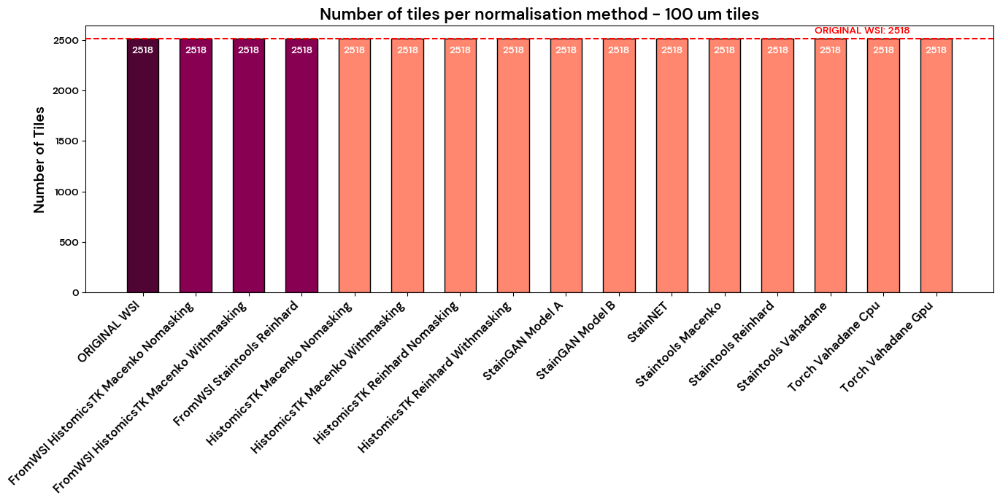

In [16]:
plot_normalisation_tiles(final_summary_for_all_100um_normalised_tiles, tile_size)

### 1.1.2 - 68 μm normalised tiles
Now, let's repeat the previous step but with the 68 μm tiles.

In [17]:
spot_size = 68

In [18]:
path_to_68um_normalised_tiles = os.path.join(os.getcwd(), PATH_TO_NORMALISED_TILES, f"tiles_{spot_size}")
path_to_68um_normalised_tiles

df_68_norm_tiles = normalisations_summary_from_tiles(path_to_68um_normalised_tiles)
#df_68_norm_tiles.to_csv(f"{path_to_68um_normalised_tiles}summary_normalised_tiles_from_tiling_68um.csv")
df_68_norm_tiles

,Normalisation Method,Target,Number of tiles,Path to folder
0,histomicsTK_macenko_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
1,histomicsTK_macenko_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
2,histomicsTK_reinhard_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
3,histomicsTK_reinhard_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
4,stainGAN_model_A,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
5,stainGAN_model_B,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
6,stainNET,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
7,staintools_macenko,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
8,staintools_reinhard,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
9,staintools_vahadane,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...


In [19]:
df_from_wsis_68_norm_tiles = pd.DataFrame()

# looping over all the paths to the tiles derived from WSIs
for path in paths_to_tiles_from_wsis:
    
    path_to_68 = os.path.join(path, f"tiles_{spot_size}/")
    path_to_68
    
    df = normalisations_summary_from_visium_WSI(path_to_68, IMAGE_VERSION_AND_COORDINATE_SYSTEM)
    df_from_wsis_68_norm_tiles = pd.concat([df_from_wsis_68_norm_tiles, df], ignore_index=True)
    
#df_from_wsis_68_norm_tiles.to_csv(f"{path_to_68}summary_tiles_from_WSIs_68um.csv")
df_from_wsis_68_norm_tiles

Processing folder: img_not_changed_allspots
2518
Processing folder: img_not_changed_allspots_histomicsTK_macenko_nomasking_target_is_reference_full
2518
Processing folder: img_not_changed_allspots_histomicsTK_macenko_withmasking_target_is_reference_full
2518
Processing folder: img_not_changed_allspots_staintools_reinhard_target_is_reference_full
2518


,Normalisation Method,Target,Number of tiles,Path to folder
0,ORIGINAL WSI,-,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
1,fromWSI_histomicsTK_macenko_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
2,fromWSI_histomicsTK_macenko_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
3,fromWSI_staintools_reinhard,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...


Let's print out one.

In [20]:
df_from_wsis_68_norm_tiles.loc[1, "Path to folder"]

'/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/visium_FFPE_dcis_idc_10X/tiling_output/img_not_changed_allspots_histomicsTK_macenko_nomasking_target_is_reference_full/tiles_68/'

In [21]:
final_summary_for_all_68um_normalised_tiles = pd.concat([df_from_wsis_68_norm_tiles, df_68_norm_tiles])

# save the table
final_summary_for_all_68um_normalised_tiles.to_csv(os.path.join(path_to_68um_normalised_tiles, f"final_summary_for_all_{spot_size}um_normalised_tiles.csv"))
final_summary_for_all_68um_normalised_tiles

,Normalisation Method,Target,Number of tiles,Path to folder
0,ORIGINAL WSI,-,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
1,fromWSI_histomicsTK_macenko_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
2,fromWSI_histomicsTK_macenko_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
3,fromWSI_staintools_reinhard,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
0,histomicsTK_macenko_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
1,histomicsTK_macenko_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
2,histomicsTK_reinhard_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
3,histomicsTK_reinhard_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
4,stainGAN_model_A,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
5,stainGAN_model_B,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...


Let's have a more direct view at it as a histogram.

In [22]:
# Filter for Target being '-' or 'target_is_reference_full'
df_filtered_68 = final_summary_for_all_68um_normalised_tiles[final_summary_for_all_68um_normalised_tiles["Target"].isin(["-", TARGET_IS])]
# Highlight "ORIGINAL WSI" separately
original_value = df_filtered_68[df_filtered_68["Normalisation Method"] == "ORIGINAL WSI"]["Number of tiles"].iloc[0]

# New names for better appearence
new_names = [cap_sentence(i.replace("_", " ")) for i in df_filtered_68["Normalisation Method"]]

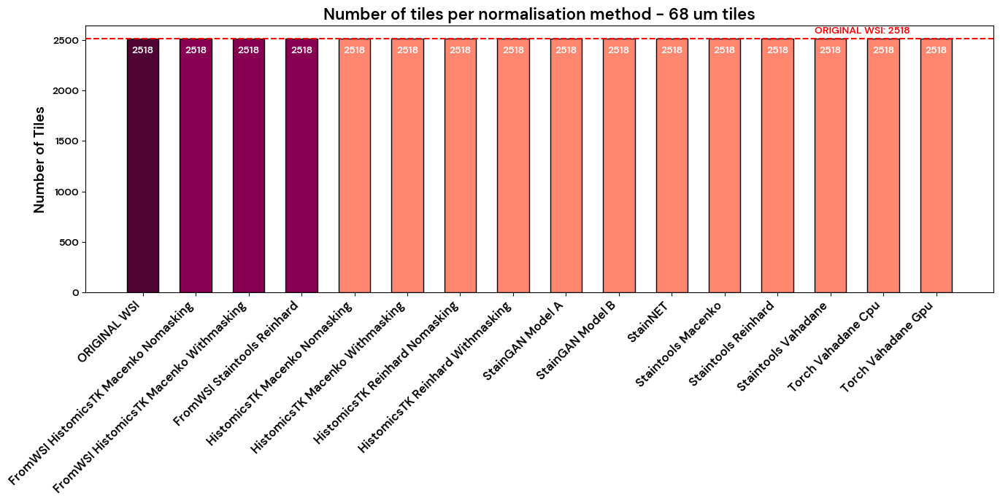

In [23]:
plot_normalisation_tiles(final_summary_for_all_68um_normalised_tiles, spot_size)

---

# 2. - Quality control
So, referring to the number of computed normalisations for each method, we can say that now the cropping function is working properly as all the images for all the methods have been correctly normalised.\
Now, let's visualised some of them.

Let's specify the name of the tile that we want to plot. The barcode and the grid coordinate system names are enough.

In [ ]:
# # for FF sample
# TILE_TO_VISUALISE = "TACCGATCCAACACTT-1_row1_col1_"  #barcode_rowingrid_coloumningrid

In [44]:
# for FFPE sample
# TILE_TO_VISUALISE = "AAACAGGGTCTATATT-1_row47_col13_"  #barcode_rowingrid_coloumningrid
TILE_TO_VISUALISE = "AAGAGATGAATCGGTA-1_row27_col27_"  #barcode_rowingrid_coloumningrid

## 2.1 - Visualisation of some 100 μm normalised tiles

Once again, here wee are referring to the tiles normalised with the target initially specified.

In [41]:
#print(df_filtered_100)
temp_for_plotting_specific_tile_100 = df_filtered_100.loc[:, ["Normalisation Method", "Path to folder"]]
temp_for_plotting_specific_tile_100.loc[:, "Normalisation Method"] = new_names

list_of_lists_100 = temp_for_plotting_specific_tile_100.values.tolist()
list_of_lists_100.insert(1, ["Target image", PATH_TO_REFERENCE])

In [42]:
list_of_lists_100

[['ORIGINAL WSI',
  '/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/visium_FFPE_dcis_idc_10X/tiling_output/img_not_changed_allspots/tiles_100/'],
 ['Target image', './reference_images/reference_full.jpeg'],
 ['FromWSI HistomicsTK Macenko Nomasking',
  '/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/visium_FFPE_dcis_idc_10X/tiling_output/img_not_changed_allspots_histomicsTK_macenko_nomasking_target_is_reference_full/tiles_100/'],
 ['FromWSI HistomicsTK Macenko Withmasking',
  '/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/visium_FFPE_dcis_idc_10X/tiling_output/img_not_changed_allspots_histomicsTK_macenko_withmasking_target_is_reference_full/tiles_100/'],
 ['FromWSI Staintools Reinhard',
  '/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/visium_FFPE_dcis_idc_10X/tiling_output/img_not_changed_allspots_staintools_reinhard_target_is_reference_full/tiles_100/'],
 ['HistomicsTK Macenko Nomasking',
  '/disk2/work/gabgam/gigi_env/the_project/2_image_normalisa

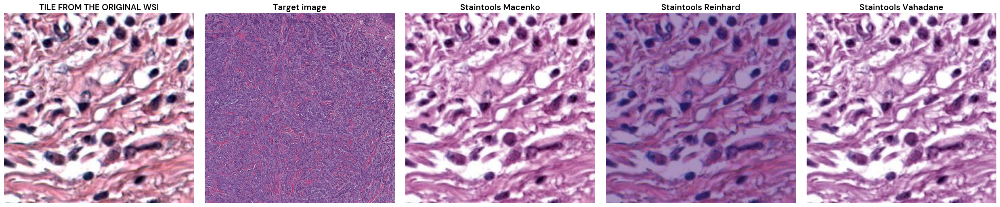

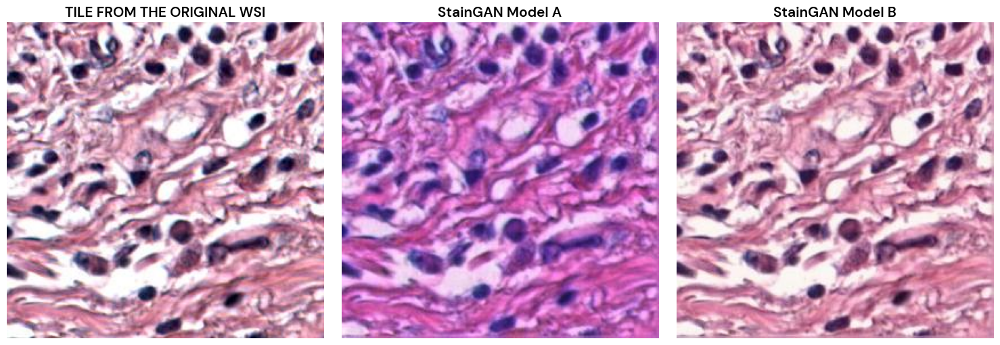

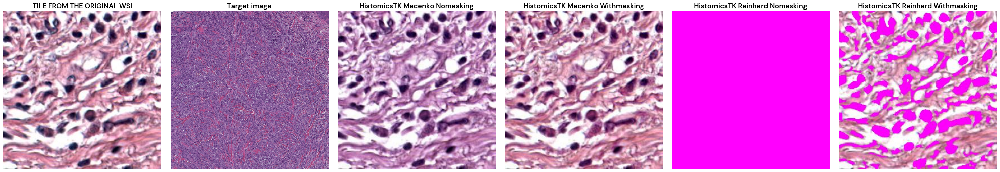

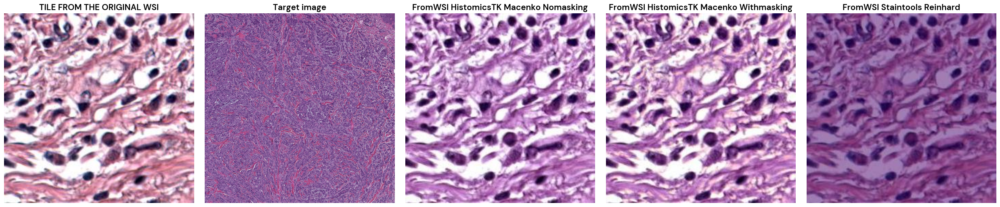

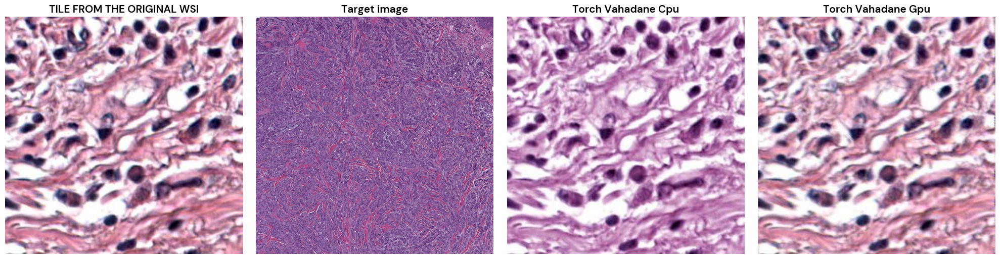

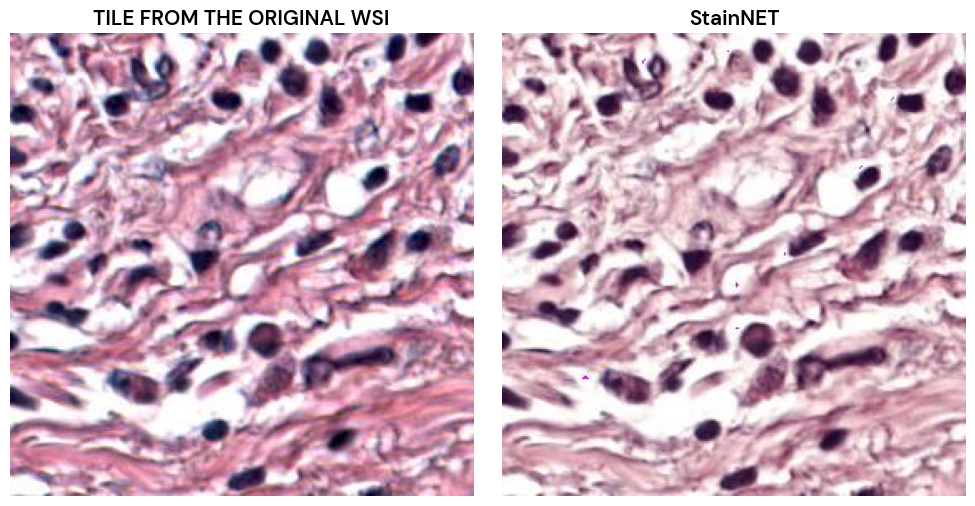

In [45]:
plot_comparison_by_origin(list_of_lists_100, tile_to_visualise=TILE_TO_VISUALISE, tile_size=f"{tile_size}um")

## 2.2 - Visualisation of some 68 um normalised tiles

In [33]:
#print(df_filtered_68)
temp_for_plotting_specific_tile_68 = df_filtered_68.loc[:, ["Normalisation Method", "Path to folder"]]
temp_for_plotting_specific_tile_68.loc[:, "Normalisation Method"] = new_names

list_of_lists_68 = temp_for_plotting_specific_tile_68.values.tolist()
list_of_lists_68.insert(1, ["Target image", PATH_TO_REFERENCE])

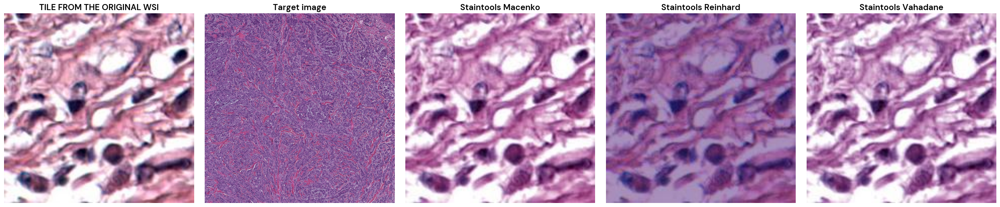

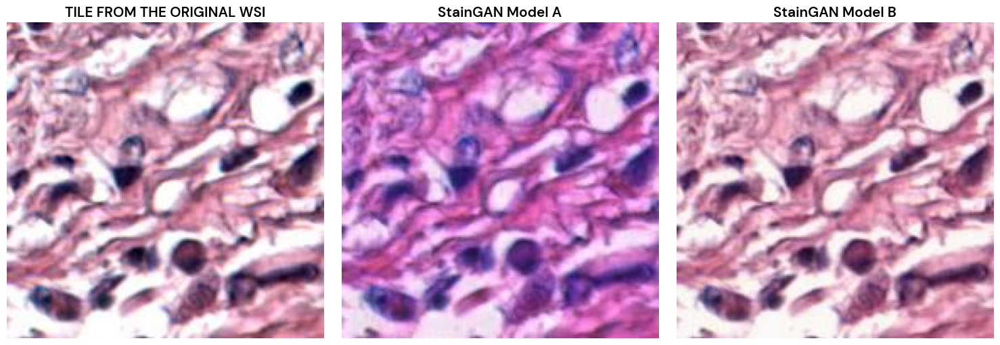

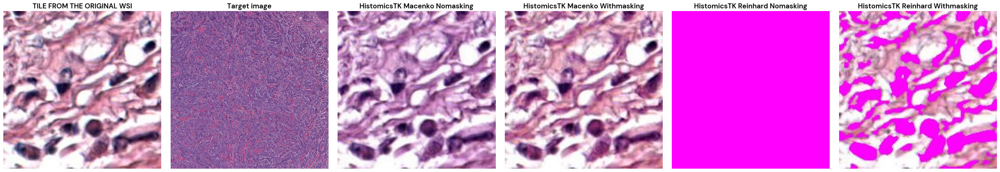

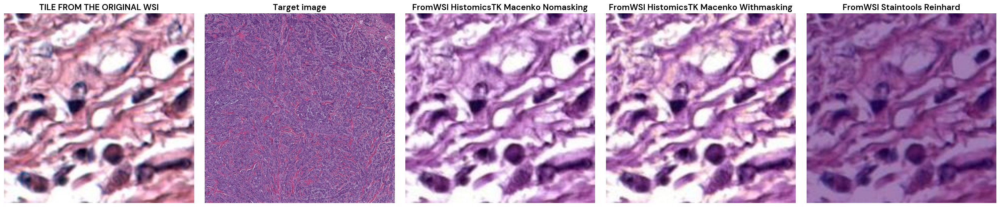

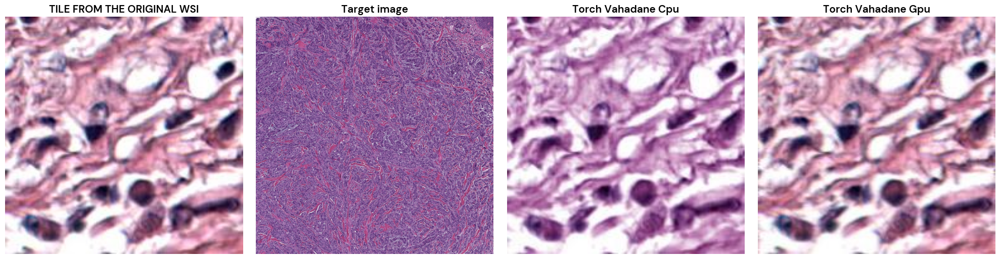

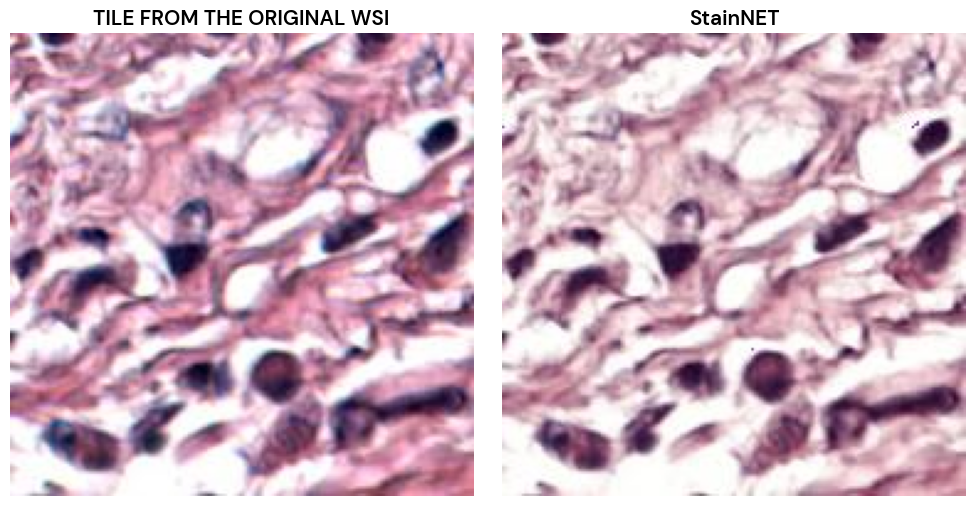

In [46]:
plot_comparison_by_origin(list_of_lists_68, tile_to_visualise=TILE_TO_VISUALISE, tile_size=f"{spot_size}um")

---
## 2.3 - Checking for white tiles

Some tiles will partially be white, so, referring to the original tiles, let's determine which these are based on the "white" background-color sampled from the image.\
In particular, the RGB conversion of the color is `[214, 207, 210]` for the Fresh-Frozen Visium sample and can be visualised [here](https://rgb.to/214,207,210).\
For the FFPE, the background color is `[255, 255, 255]` , which is pure white.

### 2.3.1 - 100 um tiles

In [35]:
# saving dataframe
too_many_whites_100 = pd.DataFrame(columns = ["Tile name", "White percentage"])
# path to folder
path_to_original_100 = os.path.join(PATH_TO_TILES_DIRECTORY, IMAGE_VERSION_AND_COORDINATE_SYSTEM, "tiles_100")
# setting the parameters

# The reference color is defined at first in the initial cell with all the other slide-specific information
tolerance = 50
white_percentage_threshold = 50

# looping over every tile in the folder
for tile in os.listdir(path_to_original_100):
    tile_result = calculate_white_percentage(os.path.join(path_to_original_100, tile), REFERENCE_COLOR, tolerance, white_percentage_threshold)
    if tile_result is not None:
        too_many_whites_100 = pd.concat([too_many_whites_100, tile_result], ignore_index=True)
    

too_many_whites_100.to_csv(os.path.join(PATH_TO_TILES_DIRECTORY, 
                                        IMAGE_VERSION_AND_COORDINATE_SYSTEM, 
                                        f"original_100um_tiles_with_more_than_{white_percentage_threshold}%_white.csv"))
too_many_whites_100

,Tile name,White percentage
0,GTAGACAACCGATGAA-1_row7_col55_100um.jpg,80.818798
1,ACAGATTAGGTTAGTG-1_row7_col57_100um.jpg,69.019461
2,ATTATCTCGACAGATC-1_row7_col61_100um.jpg,54.975157
3,TGAGATCAAATACTCA-1_row7_col63_100um.jpg,56.329900
4,CAACTTGTAGTGGGCA-1_row9_col41_100um.jpg,50.984680
...,...,...
122,CTGTAGTGAGGATCGA-1_row69_col43_100um.jpg,60.078412
123,TCCACATCGTATATTG-1_row69_col67_100um.jpg,50.784121
124,TCCTTGTCCTTTAATT-1_row69_col69_100um.jpg,55.026914
125,CGGGCGATGGATCACG-1_row69_col75_100um.jpg,58.023653


Let's have a quick visualisation of them.

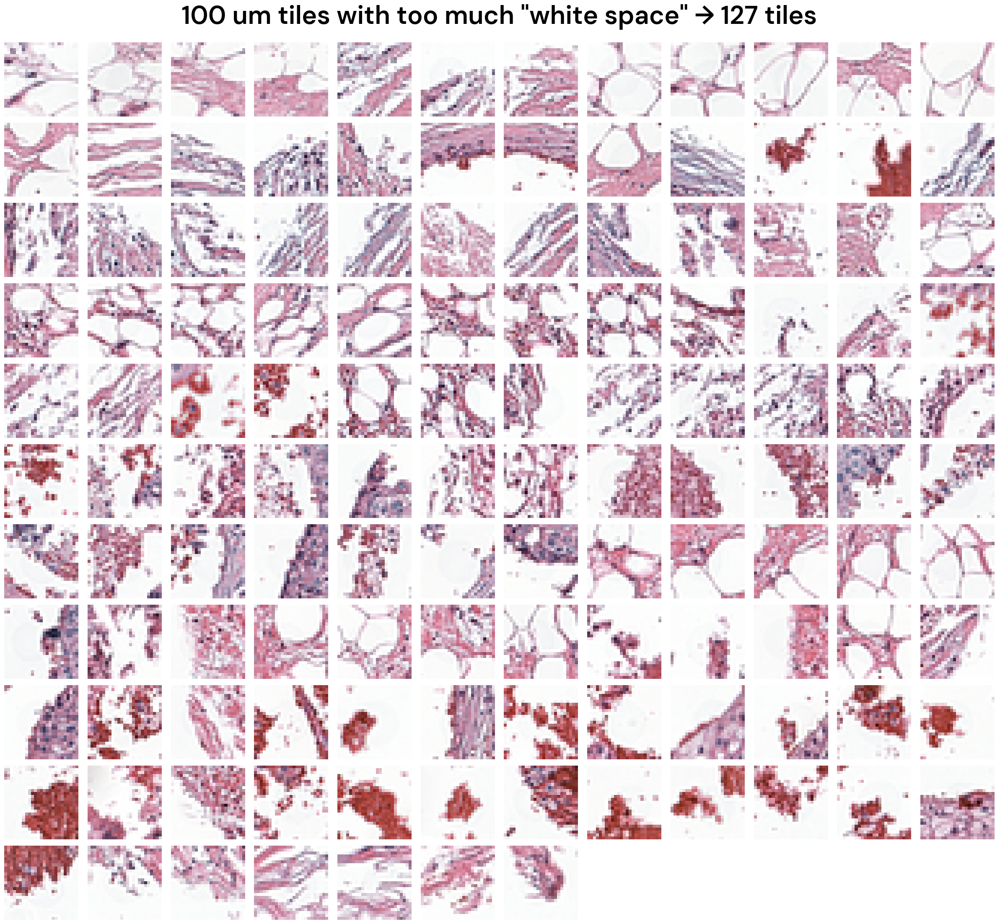

In [36]:
# Number of images
num_images = len(too_many_whites_100)

# Compute optimal rows and cols
n_cols = math.ceil(math.sqrt(num_images))  # Columns to form a square-like shape
n_rows = math.ceil(num_images / n_cols)  # Ensure enough rows to fit all images

# Create a figure and axes
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 2, n_rows * 2))

# Flatten axes array if multiple rows/columns exist
axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

# Set plot parameters
size_for_plotting = (25, 25)

# Plot images
for i, ax in enumerate(axes):
    if i < num_images:
        tile_path = os.path.join(path_to_original_100, too_many_whites_100.iloc[i][0])
        tile = Image.open(tile_path).resize(size_for_plotting, Image.Resampling.LANCZOS)
        ax.imshow(tile)
        ax.axis("off")  # Hide axes
    else:
        ax.axis("off")  # Hide empty subplots

# Adjust layout
fig.suptitle(f"{tile_size} um tiles with too much \"white space\" → {num_images} tiles", fontsize=n_rows*4, fontweight="bold", y=1.0001)
plt.tight_layout()
#fig.savefig(os.path.join(FIGURES_PATH, f"original_{tile_size}um_tiles_with_too_much_white.pdf"), format="pdf", bbox_inches="tight")
#fig.savefig(os.path.join(FIGURES_PATH, f"original_{tile_size}um_tiles_with_too_much_white.png"), format="png", dpi=300, bbox_inches="tight")
#plt.show()


### 2.3.2 - 68 um tiles

In [37]:
# saving dataframe
too_many_whites_68 = pd.DataFrame(columns = ["Tile name", "White percentage"])
# path to folder
path_to_original_68 = final_summary_for_all_68um_normalised_tiles[final_summary_for_all_68um_normalised_tiles['Normalisation Method'] == 'ORIGINAL WSI']['Path to folder'][0]
# setting the parameters

# The reference color is defined at first in the initial cell with all the other slide-specific information
tolerance = 50 
white_percentage_threshold = 50

# looping over every tile in the folder
for tile in os.listdir(path_to_original_68):
    tile_result = calculate_white_percentage(os.path.join(path_to_original_68, tile), REFERENCE_COLOR, tolerance, white_percentage_threshold)
    if tile_result is not None:
        too_many_whites_68 = pd.concat([too_many_whites_68, tile_result], ignore_index=True)
    
too_many_whites_68.to_csv(os.path.join(PATH_TO_TILES_DIRECTORY, 
                                        IMAGE_VERSION_AND_COORDINATE_SYSTEM, 
                                        f"original_68um_tiles_with_more_than_{white_percentage_threshold}%_white.csv"))
too_many_whites_68

,Tile name,White percentage
0,GTAGACAACCGATGAA-1_row7_col55_68um.jpg,76.706089
1,ACAGATTAGGTTAGTG-1_row7_col57_68um.jpg,76.284518
2,TGAGATCAAATACTCA-1_row7_col63_68um.jpg,54.464690
3,CAACTTGTAGTGGGCA-1_row9_col41_68um.jpg,51.094952
4,AATATCAAGGTCGGAT-1_row8_col42_68um.jpg,66.412970
...,...,...
126,TGCATGTGACCCATAG-1_row68_col38_68um.jpg,79.778746
127,CTGTAGTGAGGATCGA-1_row69_col43_68um.jpg,50.916704
128,TCCACATCGTATATTG-1_row69_col67_68um.jpg,53.921458
129,TCCTTGTCCTTTAATT-1_row69_col69_68um.jpg,66.421458


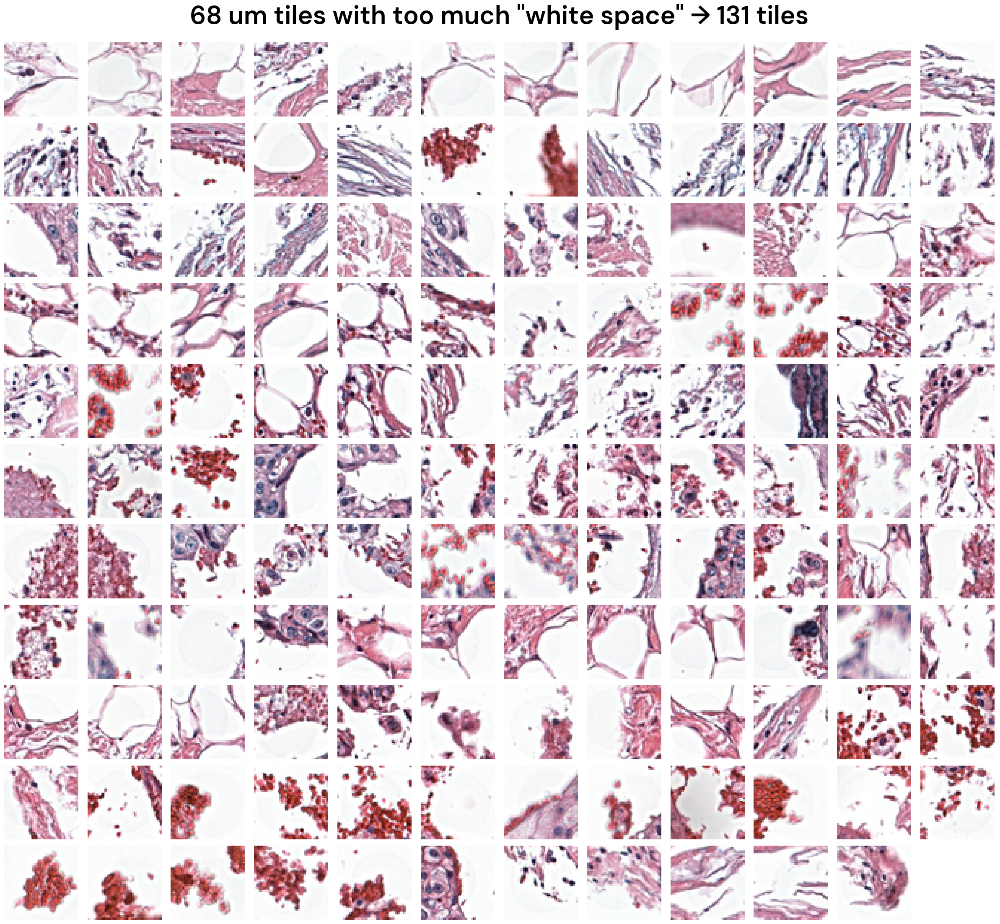

In [38]:
# Number of images
num_images = len(too_many_whites_68)

# Compute optimal rows and cols
n_cols = math.ceil(math.sqrt(num_images))  # Columns to form a square-like shape
n_rows = math.ceil(num_images / n_cols)  # Ensure enough rows to fit all images

# Create a figure and axes
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 2, n_rows * 2))

# Flatten axes array if multiple rows/columns exist
axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

# Set plot parameters
size_for_plotting = (50, 50)

# Plot images
for i, ax in enumerate(axes):
    if i < num_images:
        tile_path = os.path.join(path_to_original_68, too_many_whites_68.iloc[i][0])
        tile = Image.open(tile_path).resize(size_for_plotting, Image.Resampling.LANCZOS)
        ax.imshow(tile)
        ax.axis("off")  # Hide axes
    else:
        ax.axis("off")  # Hide empty subplots

# Adjust layout
fig.suptitle(f"{spot_size} um tiles with too much \"white space\" → {num_images} tiles", fontsize=n_rows*4, fontweight="bold", y=1.0001)
plt.tight_layout()
fig.savefig(os.path.join(FIGURES_PATH, f"original_{spot_size}um_tiles_with_too_much_white.pdf"), format="pdf", bbox_inches="tight")
fig.savefig(os.path.join(FIGURES_PATH, f"original_{spot_size}um_tiles_with_too_much_white.png"), format="png", dpi=300, bbox_inches="tight")
plt.show()

## 2.4 - Evaluation of normalisation
[SSIM](https://scikit-image.org/docs/dev/auto_examples/transform/plot_ssim.html)

[PSNR](https://scikit-image.org/docs/dev/api/skimage.metrics.html?highlight=structural_similarity#skimage.metrics.peak_signal_noise_ratio)

[LPIPS](https://github.com/richzhang/PerceptualSimilarity/tree/master)

You can improve the code with the `Torch` version of these metrics: https://lightning.ai/docs/torchmetrics/stable/image/structural_similarity.html


### 2.4.1 - 100 um tiles

In [39]:
excluded_tiles_100 = too_many_whites_100["Tile name"].tolist()
selected_tiles_100 = [i for i in os.listdir(path_to_original_100) if i not in excluded_tiles_100 and i.endswith(".jpg")]
print(f"Number of selected tiles: {len(selected_tiles_100)}")

norm_methods = new_names
norm_paths = df_filtered_100.loc[:, "Path to folder"]

Number of selected tiles: 2391


In [35]:
ssim_df_100, psnr_df_100 = compute_similarity_metrics(selected_tiles_100, path_to_original_100, norm_methods, norm_paths, tile_size, PATH_TO_NORMALISED_TILES)

#### 2.4.1.1 - SSIM
The dataframes were saved as `ssim_of_methods_for_non_white_tiles_<TILE_SIZE>um.csv` and `psnr_of_methods_for_non_white_tiles_<TILE_SIZE>um.csv` in the output folder.\
Considering that it takes almost 1 hour for the previous chunk to run, I'm going to access the dataframe from the file in the folder (if it already exists).

In [36]:
ssim_df_100 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{tile_size}", "ssim_of_methods_for_non_white_tiles_100um.csv"), index_col= [0])
ssim_df_100.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
TGGTATCGGTCTGTAT-1_row7_col59_100um.jpg,0.953474,0.947242,0.712443,0.987395,0.985361,0.262200,0.436906,0.761532,0.769881,0.943986,0.856859,0.832465,0.892090,0.887634,0.867102
ACTCAGACCTGCTTCT-1_row9_col43_100um.jpg,0.956612,0.954791,0.707724,0.980831,0.984711,0.131274,0.453833,0.645515,0.661650,0.950714,0.959087,0.774855,0.957919,0.967236,0.980451
GGATACTCATGAATTG-1_row9_col45_100um.jpg,0.955420,0.949053,0.701696,0.980863,0.982604,0.109640,0.396971,0.651605,0.662101,0.953817,0.952648,0.817571,0.958406,0.957492,0.974834
TGGGCACAAACAGAAC-1_row8_col46_100um.jpg,0.964737,0.964044,0.738902,0.985756,0.987485,0.250682,0.506510,0.723003,0.736128,0.952047,0.956710,0.767006,0.935681,0.956176,0.977823
GAGCCACGGTAGTAGG-1_row9_col47_100um.jpg,0.958831,0.952455,0.702387,0.982766,0.984729,0.115282,0.390324,0.693336,0.716444,0.952955,0.928766,0.812258,0.887560,0.926986,0.983103
TCGATAGGCTAGTCGC-1_row8_col48_100um.jpg,0.964111,0.962140,0.740477,0.985226,0.984696,0.262096,0.465872,0.736912,0.755601,0.960956,0.947361,0.781142,0.948269,0.949511,0.963403
TAACCGCCCGCAGTGC-1_row9_col49_100um.jpg,0.954032,0.946913,0.697780,0.982758,0.982694,0.117052,0.398183,0.732828,0.752445,0.955387,0.952927,0.835688,0.864471,0.947669,0.975240
GCCTATTTGCTACACA-1_row8_col50_100um.jpg,0.965098,0.963395,0.744702,0.987849,0.990931,0.273254,0.520747,0.722579,0.740441,0.960425,0.951659,0.777015,0.966650,0.962376,0.966454
TTGACGATTCAGCACG-1_row9_col51_100um.jpg,0.956256,0.948013,0.697606,0.983166,0.982023,0.109231,0.477697,0.733392,0.751955,0.958936,0.955423,0.830111,0.867766,0.951518,0.983768
ACCGAAAGGGCCCTGC-1_row9_col53_100um.jpg,0.962403,0.956835,0.700961,0.985999,0.983191,0.096237,0.422032,0.702580,0.722783,0.961717,0.974301,0.826152,0.963821,0.976370,0.967380


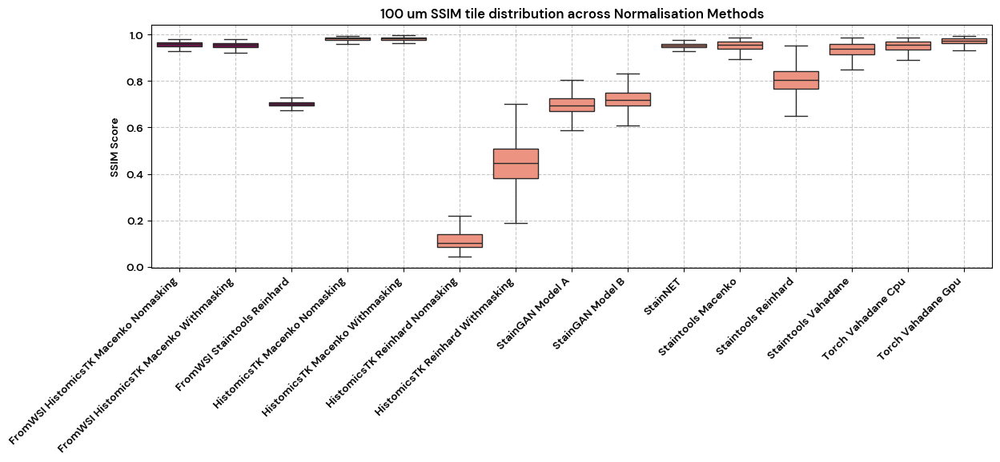

In [37]:
figure_title_ssim_100 = f"{tile_size} um SSIM tile distribution across Normalisation Methods"
ssim_fig_boxplot_100 = plot_boxplot(ssim_df_100, "SSIM", figure_title_ssim_100, median = False)
ssim_fig_boxplot_100

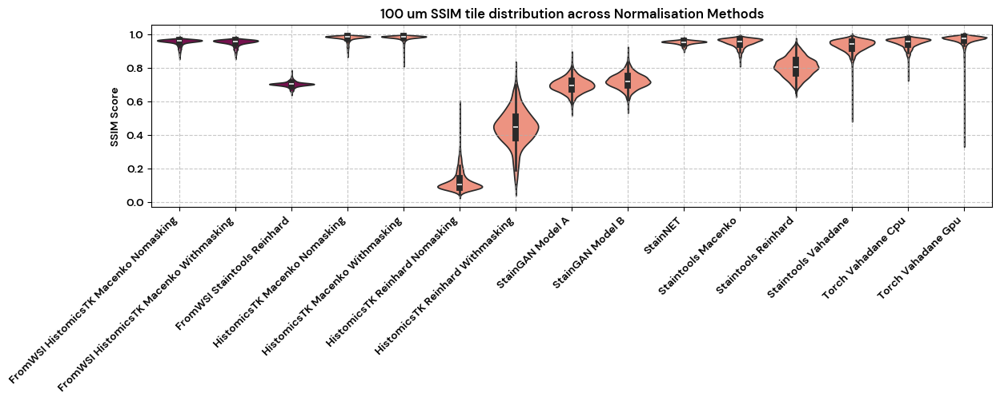

In [38]:
figure_title_ssim_100 = f"{tile_size} um SSIM tile distribution across Normalisation Methods"
ssim_fig_violinplot_100 = plot_violinplot(ssim_df_100, "SSIM", figure_title_ssim_100, median = False)
#ssim_fig_violinplot_100

In [39]:
ssim_100_median_n_mean = pd.DataFrame([round(ssim_df_100.median(), 3), round(ssim_df_100.mean(), 3)], index = ["Median", "Mean"])
ssim_100_median_n_mean

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
Median,0.959,0.955,0.701,0.982,0.983,0.103,0.445,0.696,0.719,0.953,0.956,0.805,0.939,0.956,0.974
Mean,0.952,0.950,0.701,0.976,0.977,0.122,0.441,0.697,0.721,0.950,0.949,0.805,0.931,0.948,0.965


---

#### 2.4.1.2 - PSNR

In [40]:
psnr_df_100 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{tile_size}", f"psnr_of_methods_for_non_white_tiles_{tile_size}um.csv"), index_col= [0])
psnr_df_100.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
TGGTATCGGTCTGTAT-1_row7_col59_100um.jpg,25.038486,27.022398,6.011107,27.004488,30.250317,6.369890,12.596475,16.639801,21.640313,21.439067,14.115203,7.641173,15.718615,15.652373,15.074138
ACTCAGACCTGCTTCT-1_row9_col43_100um.jpg,24.779612,25.588778,8.829510,27.253680,30.652810,6.437054,12.137283,16.238115,19.198817,22.966905,23.608929,10.082362,23.999090,25.708505,27.478275
GGATACTCATGAATTG-1_row9_col45_100um.jpg,24.138134,25.049917,8.868604,26.535670,30.406651,6.752975,12.029575,16.882893,19.728889,22.424398,21.032094,11.106499,22.510291,22.171352,23.599225
TGGGCACAAACAGAAC-1_row8_col46_100um.jpg,26.207990,27.109495,7.579705,28.306716,31.399313,6.014623,12.429325,17.318719,20.418959,23.869377,21.706204,7.599474,21.228113,22.330372,24.352474
GAGCCACGGTAGTAGG-1_row9_col47_100um.jpg,24.335374,25.234838,8.798394,26.493353,30.846566,6.703349,11.794183,16.691415,20.232599,22.548135,19.390215,10.878602,18.804502,20.114211,25.805776
TCGATAGGCTAGTCGC-1_row8_col48_100um.jpg,25.564309,26.403085,7.597421,27.431601,30.640914,6.114383,12.145119,17.113316,21.390742,23.930802,19.711999,7.795158,20.586318,20.539304,21.703900
TAACCGCCCGCAGTGC-1_row9_col49_100um.jpg,23.762385,24.486913,8.881438,26.055884,30.761683,6.859647,12.071629,17.474843,20.808929,22.358821,21.057773,11.361739,18.495239,21.159908,24.609747
GCCTATTTGCTACACA-1_row8_col50_100um.jpg,26.131335,27.191343,7.483313,28.951268,32.465511,6.037325,12.596146,17.162544,20.888788,24.305502,20.618585,7.639406,23.098753,22.424898,22.614531
TTGACGATTCAGCACG-1_row9_col51_100um.jpg,23.567302,24.352049,9.053819,25.540200,31.418157,6.862387,12.865023,17.631151,21.416425,22.351075,22.798452,11.321374,18.712552,22.188191,27.418880
ACCGAAAGGGCCCTGC-1_row9_col53_100um.jpg,24.188014,25.300807,8.900631,26.024421,30.404821,6.790554,12.357537,17.094772,20.610622,22.531208,23.871508,11.085222,23.218464,25.089816,24.179502


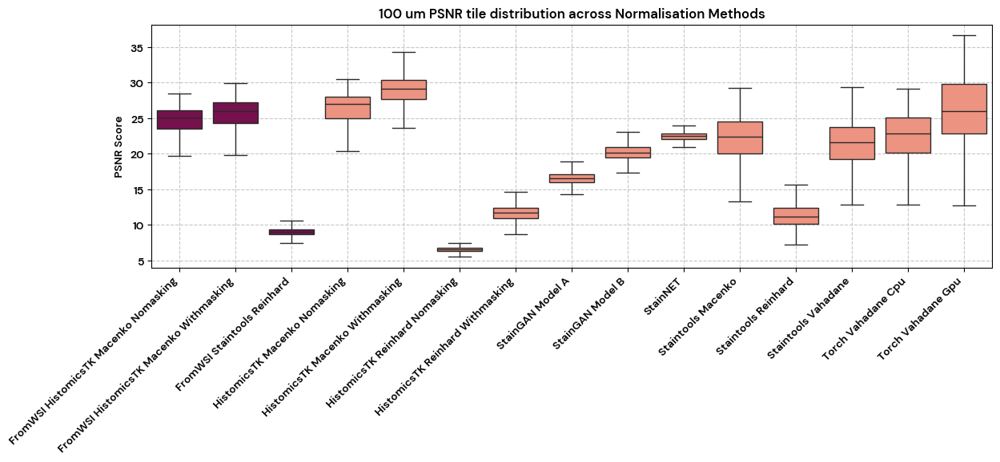

In [41]:
figure_title_psnr_100 = f"{tile_size} um PSNR tile distribution across Normalisation Methods"
psnr_fig_boxplot_100 = plot_boxplot(psnr_df_100, "PSNR", figure_title_psnr_100, median = False)
psnr_fig_boxplot_100

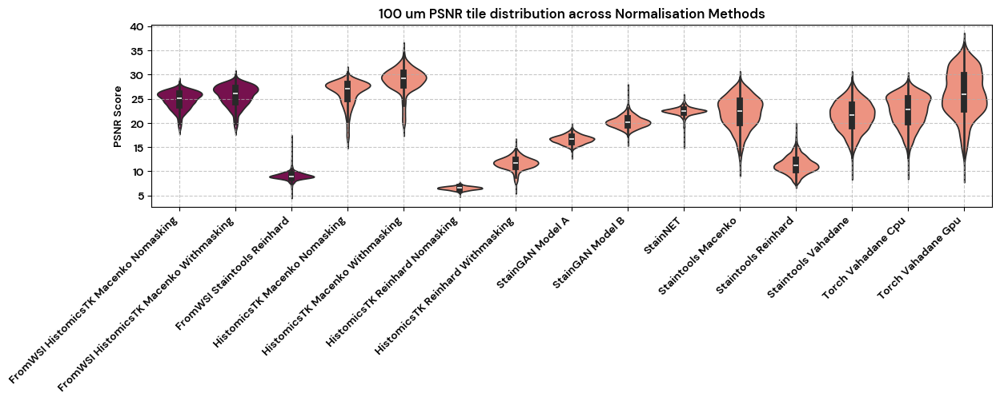

In [42]:
figure_title_psnr_100 = f"{tile_size} um PSNR tile distribution across Normalisation Methods"
psnr_fig_violinplot_100 = plot_violinplot(psnr_df_100, "PSNR", figure_title_psnr_100, median = False)
#psnr_fig_violinplot_100

In [43]:
psnr_100_median_n_mean = pd.DataFrame([round(psnr_df_100.median(), 3), round(psnr_df_100.mean(), 3)], index = ["Median", "Mean"])
psnr_100_median_n_mean

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
Median,25.072,26.061,8.991,27.046,29.161,6.525,11.702,16.611,20.155,22.470,22.417,11.191,21.609,22.812,25.987
Mean,24.708,25.646,9.051,26.180,28.831,6.519,11.651,16.592,20.236,22.404,22.140,11.324,21.452,22.454,26.072


---
#### 2.4.1.3 - LPIPS

In [44]:
lpips_df_100 = compute_lpips_metrics(selected_tiles_100, path_to_original_100, norm_methods, norm_paths, tile_size, PATH_TO_NORMALISED_TILES, use_gpu=True)

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/lpips/weights/v0.1/alex.pth


/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(

In [45]:
lpips_df_100 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{tile_size}", f"lpips_of_methods_for_non_white_tiles_{tile_size}um.csv"), index_col= [0])
lpips_df_100.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
TGGTATCGGTCTGTAT-1_row7_col59_100um.jpg,0.091942,0.096048,0.316272,0.043909,0.049962,0.851702,0.584328,0.160139,0.067450,0.094136,0.130113,0.229839,0.122144,0.118942,0.104289
ACTCAGACCTGCTTCT-1_row9_col43_100um.jpg,0.118669,0.105321,0.249552,0.067006,0.051628,0.852088,0.551354,0.208373,0.081060,0.098479,0.091915,0.226710,0.100421,0.090673,0.026451
GGATACTCATGAATTG-1_row9_col45_100um.jpg,0.099502,0.096555,0.230987,0.058376,0.049151,0.829614,0.567453,0.186852,0.079714,0.097587,0.080056,0.173259,0.082844,0.082068,0.020437
TGGGCACAAACAGAAC-1_row8_col46_100um.jpg,0.086993,0.080991,0.321398,0.052352,0.048797,0.877968,0.531449,0.174519,0.069201,0.095386,0.077274,0.312842,0.097276,0.081830,0.018805
GAGCCACGGTAGTAGG-1_row9_col47_100um.jpg,0.096491,0.091842,0.256608,0.052544,0.048383,0.849916,0.595538,0.201788,0.076808,0.095547,0.106736,0.194956,0.138468,0.110024,0.016438
TCGATAGGCTAGTCGC-1_row8_col48_100um.jpg,0.075641,0.071027,0.284886,0.046086,0.041200,0.825685,0.488771,0.145964,0.057380,0.071904,0.066294,0.277620,0.072810,0.069233,0.024998
TAACCGCCCGCAGTGC-1_row9_col49_100um.jpg,0.105895,0.101951,0.232366,0.056409,0.049560,0.812986,0.596785,0.205008,0.081208,0.094159,0.082247,0.166796,0.148689,0.088313,0.022978
GCCTATTTGCTACACA-1_row8_col50_100um.jpg,0.070388,0.060768,0.282960,0.036336,0.029040,0.834664,0.460255,0.160154,0.059492,0.066399,0.066163,0.275513,0.057184,0.059900,0.031509
TTGACGATTCAGCACG-1_row9_col51_100um.jpg,0.092571,0.087331,0.220312,0.049177,0.045024,0.795658,0.571955,0.191498,0.069936,0.087790,0.074982,0.165870,0.140211,0.082373,0.019603
ACCGAAAGGGCCCTGC-1_row9_col53_100um.jpg,0.106198,0.101732,0.232972,0.059218,0.062146,0.779036,0.573533,0.206899,0.075881,0.092340,0.067103,0.171728,0.083279,0.070649,0.030486


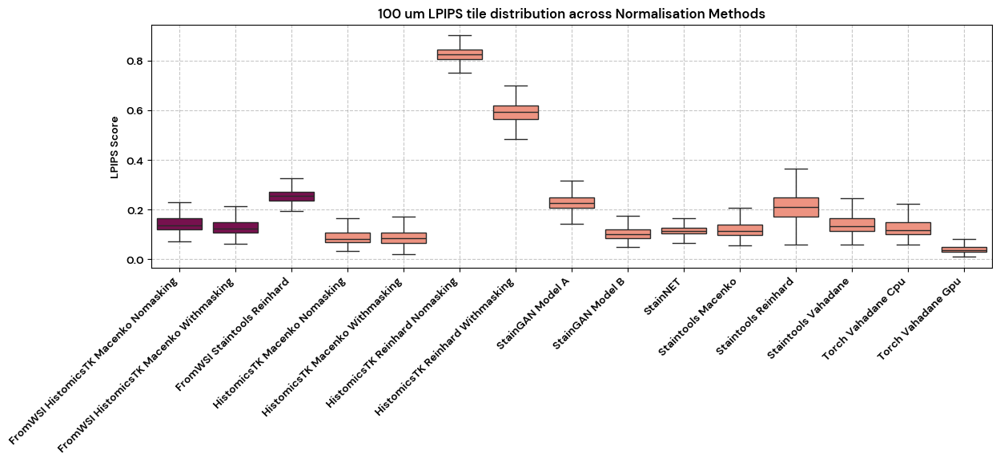

In [46]:
figure_title_lpips_100 = f"{tile_size} um LPIPS tile distribution across Normalisation Methods"
lpips_fig_boxplot_100 = plot_boxplot(lpips_df_100, "LPIPS", figure_title_lpips_100, median = False)
lpips_fig_boxplot_100

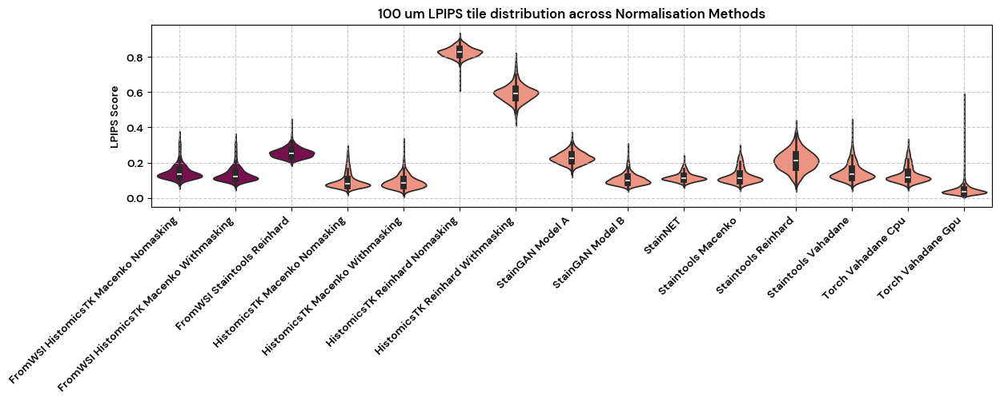

In [47]:
figure_title_lpips_100 = f"{tile_size} um LPIPS tile distribution across Normalisation Methods"
lpips_fig_violinplot_100 = plot_violinplot(lpips_df_100, "LPIPS", figure_title_lpips_100, median = False)
#lpips_fig_violinplot_100

### 2.4.2 - 68 um tiles

In [48]:
excluded_tiles_68 = too_many_whites_68["Tile name"].tolist()
selected_tiles_68 = [i for i in os.listdir(path_to_original_68) if i not in excluded_tiles_68 and i.endswith(".jpg")]
print(f"Number of selected tiles: {len(selected_tiles_68)}")

norm_methods = new_names
norm_paths = df_filtered_68.loc[:, "Path to folder"]
df_filtered_68

Number of selected tiles: 2387


,Normalisation Method,Target,Number of tiles,Path to folder
0,ORIGINAL WSI,-,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
1,fromWSI_histomicsTK_macenko_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
2,fromWSI_histomicsTK_macenko_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
3,fromWSI_staintools_reinhard,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/1_tili...
0,histomicsTK_macenko_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
1,histomicsTK_macenko_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
2,histomicsTK_reinhard_nomasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
3,histomicsTK_reinhard_withmasking,target_is_reference_full,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
4,stainGAN_model_A,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...
5,stainGAN_model_B,-,2518,/disk2/work/gabgam/gigi_env/the_project/2_imag...


In [49]:
ssim_df_68, psnr_df_68 = compute_similarity_metrics(selected_tiles_68, path_to_original_68, norm_methods, norm_paths, spot_size, PATH_TO_NORMALISED_TILES)

#### 2.4.2.1 - SSIM

In [50]:
ssim_df_68 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{spot_size}", f"ssim_of_methods_for_non_white_tiles_{spot_size}um.csv"), index_col= [0])
ssim_df_68.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
TGGTATCGGTCTGTAT-1_row7_col59_68um.jpg,0.961082,0.953965,0.708029,0.987993,0.985565,0.221515,0.395640,0.934470,0.979257,0.948329,0.866347,0.846434,0.885170,0.891912,0.868232
ATTATCTCGACAGATC-1_row7_col61_68um.jpg,0.959175,0.952174,0.704364,0.986800,0.985241,0.186286,0.348776,0.926181,0.983499,0.946363,0.887831,0.826822,0.910692,0.911134,0.870126
ACTCAGACCTGCTTCT-1_row9_col43_68um.jpg,0.955223,0.951979,0.702556,0.981918,0.986163,0.117414,0.495096,0.930387,0.981939,0.952920,0.955145,0.792297,0.944854,0.954902,0.977929
TTGGAGTCTCCCTTCT-1_row8_col44_68um.jpg,0.959711,0.959590,0.720392,0.983360,0.982783,0.208708,0.411285,0.929098,0.982587,0.942075,0.944055,0.769290,0.946527,0.945515,0.951457
GGATACTCATGAATTG-1_row9_col45_68um.jpg,0.955983,0.950046,0.700983,0.981851,0.982445,0.114363,0.393486,0.929119,0.981398,0.951059,0.935145,0.813837,0.938688,0.942075,0.967043
TGGGCACAAACAGAAC-1_row8_col46_68um.jpg,0.964137,0.963303,0.726210,0.985794,0.985936,0.205815,0.451168,0.930080,0.988702,0.952651,0.952048,0.770009,0.934034,0.950255,0.969635
GAGCCACGGTAGTAGG-1_row9_col47_68um.jpg,0.966406,0.962085,0.702996,0.984229,0.985690,0.112503,0.425623,0.926960,0.982402,0.953250,0.931759,0.783334,0.910014,0.921725,0.988167
TCGATAGGCTAGTCGC-1_row8_col48_68um.jpg,0.964087,0.961037,0.734064,0.985641,0.984792,0.229542,0.435505,0.930322,0.987181,0.959001,0.950542,0.774246,0.919578,0.941637,0.964847
TAACCGCCCGCAGTGC-1_row9_col49_68um.jpg,0.948520,0.944771,0.695136,0.980132,0.981752,0.103449,0.378390,0.927845,0.972835,0.951353,0.958651,0.820820,0.931818,0.956201,0.978045
GCCTATTTGCTACACA-1_row8_col50_68um.jpg,0.966310,0.966368,0.746446,0.988245,0.991094,0.262190,0.546465,0.933947,0.988178,0.961352,0.959060,0.760360,0.949006,0.962367,0.975211


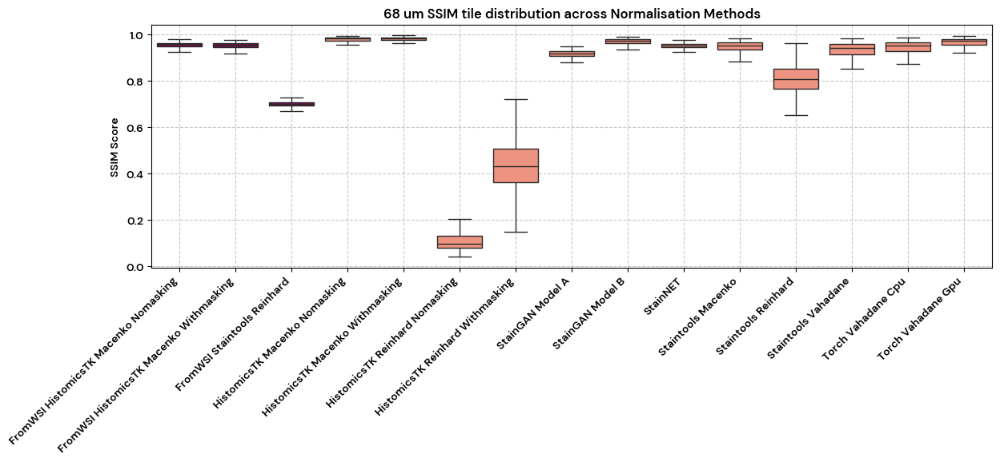

In [51]:
figure_title_ssim_68 = f"{spot_size} um SSIM tile distribution across Normalisation Methods"
ssim_fig_boxplot_68 = plot_boxplot(ssim_df_68, "SSIM", figure_title_ssim_68, median = False)
ssim_fig_boxplot_68

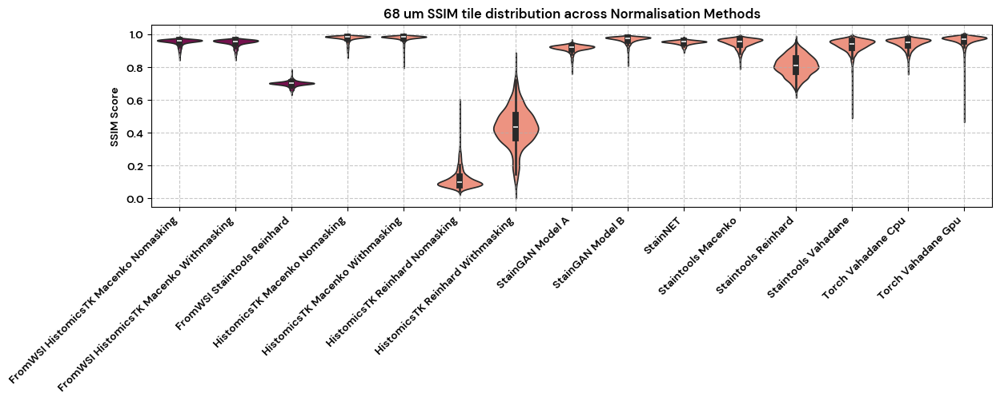

In [52]:
figure_title_ssim_68 = f"{spot_size} um SSIM tile distribution across Normalisation Methods"
ssim_fig_violinplot_68 = plot_violinplot(ssim_df_68, "SSIM", figure_title_ssim_68, median = False)
ssim_fig_violinplot_68

In [53]:
ssim_68_median_n_mean = pd.DataFrame([round(ssim_df_68.median(), 3), round(ssim_df_68.mean(), 3)], index = ["Median", "Mean"])
ssim_68_median_n_mean

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
Median,0.959,0.955,0.700,0.983,0.983,0.099,0.433,0.919,0.974,0.953,0.954,0.809,0.942,0.952,0.972
Mean,0.952,0.949,0.699,0.975,0.977,0.116,0.432,0.914,0.968,0.950,0.946,0.809,0.932,0.942,0.962


---
#### 2.4.2.2 - PSNR

In [54]:
psnr_df_68 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{spot_size}", f"psnr_of_methods_for_non_white_tiles_{spot_size}um.csv"), index_col= [0])
psnr_df_68.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
TGGTATCGGTCTGTAT-1_row7_col59_68um.jpg,24.458125,26.378605,6.244606,26.366912,30.012848,6.589207,12.647212,17.480811,24.260698,20.512257,13.882983,8.255012,14.751152,15.131579,14.869008
ATTATCTCGACAGATC-1_row7_col61_68um.jpg,25.362503,26.924268,6.540078,27.797241,30.276332,6.417666,11.818127,17.142777,26.430633,21.859149,15.399272,8.282360,16.716433,16.804931,15.367154
ACTCAGACCTGCTTCT-1_row9_col43_68um.jpg,24.413024,25.312153,8.656770,26.948954,31.226512,6.582858,12.652588,18.939006,31.548490,22.746834,22.246975,10.536510,21.964963,22.740886,27.011055
TTGGAGTCTCCCTTCT-1_row8_col44_68um.jpg,26.235078,27.008698,7.641872,28.951425,30.844145,6.119728,12.090727,19.996816,32.504564,23.690981,20.109927,7.923142,20.672202,21.194870,20.830964
GGATACTCATGAATTG-1_row9_col45_68um.jpg,24.294231,25.263737,8.753395,26.831684,30.292616,6.723471,11.923513,19.041086,30.360980,22.466019,19.031632,10.871709,20.129599,20.246172,22.256786
TGGGCACAAACAGAAC-1_row8_col46_68um.jpg,25.844299,26.560470,7.824455,28.108369,31.040081,6.164927,12.128941,19.230649,32.676657,23.606147,20.857518,8.253312,20.920698,21.601948,23.372181
GAGCCACGGTAGTAGG-1_row9_col47_68um.jpg,24.778113,25.617311,8.593019,26.982103,31.112392,6.531430,11.970424,19.290359,31.444262,22.719985,20.458108,10.530530,20.193806,20.605592,30.133035
TCGATAGGCTAGTCGC-1_row8_col48_68um.jpg,25.628772,26.310464,7.946302,27.402641,30.414350,6.174900,11.848004,19.489289,33.585147,23.295976,20.645219,8.270601,20.233395,21.177191,22.765636
TAACCGCCCGCAGTGC-1_row9_col49_68um.jpg,23.822953,24.551534,8.988157,25.984120,30.669177,6.785152,11.923958,20.062732,29.034309,22.394697,23.446741,11.343813,22.233350,23.719442,26.255660
GCCTATTTGCTACACA-1_row8_col50_68um.jpg,26.565839,27.569282,7.627376,29.179692,31.986396,5.971499,12.516175,19.910076,33.777372,24.484139,22.389047,7.610042,22.699765,23.668110,24.679512


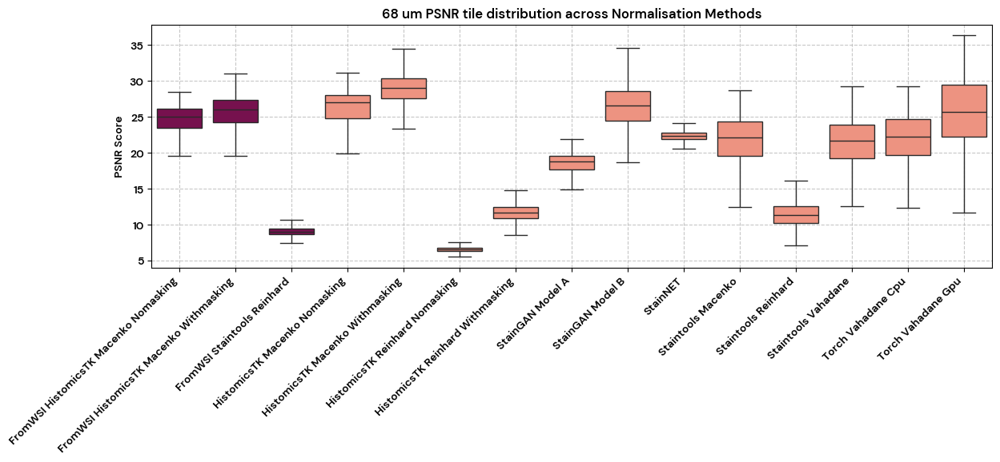

In [55]:
figure_title_psnr_68 = f"{spot_size} um PSNR tile distribution across Normalisation Methods"
psnr_fig_boxplot_68 = plot_boxplot(psnr_df_68, "PSNR", figure_title_psnr_68, median = False)
psnr_fig_boxplot_68

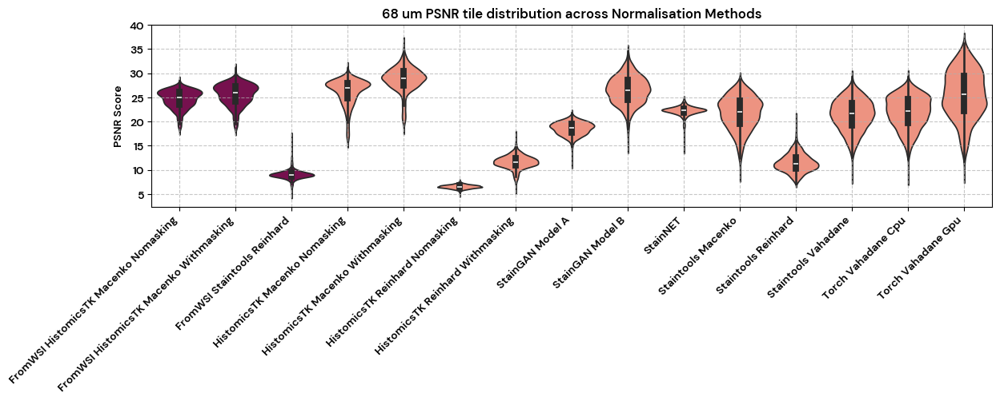

In [56]:
figure_title_psnr_68 = f"{spot_size} um PSNR tile distribution across Normalisation Methods"
psnr_fig_violinplot_68 = plot_violinplot(psnr_df_68, "PSNR", figure_title_psnr_68, median = False)
psnr_fig_violinplot_68

In [57]:
psnr_68_median_n_mean = pd.DataFrame([round(psnr_df_68.median(), 3), round(psnr_df_68.mean(), 3)], index = ["Median", "Mean"])
psnr_68_median_n_mean

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
Median,25.004,25.964,8.990,27.015,29.005,6.539,11.677,18.737,26.552,22.343,22.071,11.281,21.623,22.240,25.652
Mean,24.644,25.578,9.041,26.117,28.732,6.545,11.639,18.589,26.526,22.239,21.771,11.453,21.396,21.912,25.597


---
#### 2.4.2.3 - LPIPS

In [58]:
lpips_df_68 = compute_lpips_metrics(selected_tiles_68, path_to_original_68, norm_methods, norm_paths, spot_size, PATH_TO_NORMALISED_TILES, use_gpu=True)

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/lpips/weights/v0.1/alex.pth


/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(

In [59]:
lpips_df_68 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{spot_size}", f"lpips_of_methods_for_non_white_tiles_{spot_size}um.csv"), index_col= [0])
lpips_df_68.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
TGGTATCGGTCTGTAT-1_row7_col59_68um.jpg,0.082434,0.092125,0.292869,0.040275,0.046378,0.825052,0.630885,0.127704,0.028617,0.081845,0.124171,0.200591,0.128434,0.115448,0.111763
ATTATCTCGACAGATC-1_row7_col61_68um.jpg,0.095130,0.095542,0.280995,0.043646,0.049554,0.820207,0.580064,0.152922,0.025838,0.090892,0.120515,0.203157,0.115714,0.108702,0.082494
ACTCAGACCTGCTTCT-1_row9_col43_68um.jpg,0.110688,0.098394,0.250784,0.058248,0.045688,0.799947,0.540643,0.162274,0.023156,0.096806,0.087577,0.200035,0.107260,0.098641,0.023163
TTGGAGTCTCCCTTCT-1_row8_col44_68um.jpg,0.098921,0.087786,0.301866,0.056582,0.065009,0.873987,0.600630,0.150849,0.025219,0.103284,0.091136,0.275684,0.094060,0.093151,0.042739
GGATACTCATGAATTG-1_row9_col45_68um.jpg,0.091727,0.080525,0.223358,0.051584,0.045604,0.805960,0.524113,0.126108,0.022105,0.088010,0.079194,0.173397,0.085677,0.082849,0.021100
TGGGCACAAACAGAAC-1_row8_col46_68um.jpg,0.098530,0.091009,0.315935,0.054759,0.056854,0.856666,0.605794,0.139300,0.017220,0.098415,0.085681,0.295007,0.107131,0.094990,0.024478
GAGCCACGGTAGTAGG-1_row9_col47_68um.jpg,0.089457,0.081590,0.272262,0.052731,0.047920,0.820112,0.573636,0.162831,0.024315,0.085937,0.101900,0.238193,0.123375,0.116114,0.014030
TCGATAGGCTAGTCGC-1_row8_col48_68um.jpg,0.071967,0.069438,0.260197,0.046006,0.040816,0.808040,0.488158,0.103835,0.014384,0.073470,0.062226,0.260049,0.090507,0.077527,0.022651
TAACCGCCCGCAGTGC-1_row9_col49_68um.jpg,0.107482,0.095884,0.211024,0.055016,0.041096,0.759563,0.538155,0.155490,0.032346,0.079575,0.077905,0.172343,0.099549,0.081012,0.018660
GCCTATTTGCTACACA-1_row8_col50_68um.jpg,0.068419,0.065580,0.294140,0.036864,0.038532,0.821477,0.460401,0.128754,0.014461,0.060058,0.059359,0.294635,0.065764,0.058727,0.026808


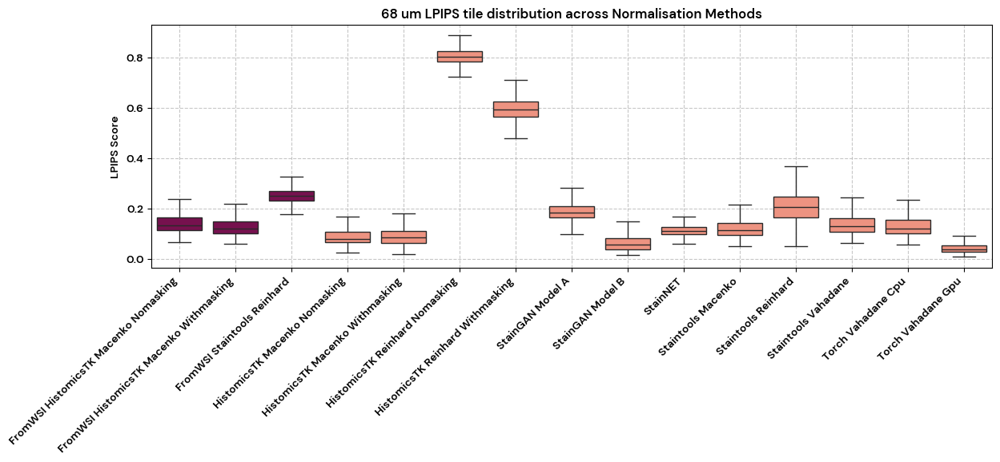

In [60]:
figure_title_lpips_68 = f"{spot_size} um LPIPS tile distribution across Normalisation Methods"
lpips_fig_boxplot_68 = plot_boxplot(lpips_df_68, "LPIPS", figure_title_lpips_68, median = False)
lpips_fig_boxplot_68

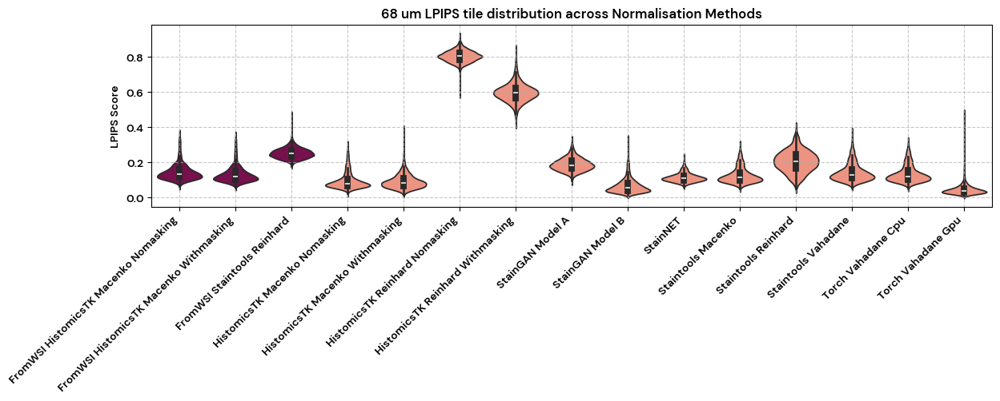

In [61]:
figure_title_lpips_68 = f"{spot_size} um LPIPS tile distribution across Normalisation Methods"
lpips_fig_violinplot_68 = plot_violinplot(lpips_df_68, "LPIPS", figure_title_lpips_68, median = False)
lpips_fig_violinplot_68

---
**Saving the environment requirements**

In [62]:
# Save package versions to a .txt file
with open("requirements_for_visualisation_n_evaluation_env.txt", "w") as f:
    subprocess.run(["pip", "freeze"], stdout=f)